# IFT 6758 - Devoir 2

In [1]:
%load_ext autoreload
%autoreload 2

## Question 1

### a)
Commencez par utiliser les fonctions créées dans `q1.py` pour rendre les données plus informatives et lisibles. Concrètement, remplissez les cellules suivantes :


In [2]:
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
from q1 import count_labels, convert_id, convert_ids, contains_label, get_conditional_proportion

sns.set(style="ticks")

In [3]:
# Charger le fichier `audio_segments.csv` dans un DataFrame `df`
df = pd.read_csv('data/audio_segments.csv')

In [4]:
# Ajouter une colonne correspondant au nombre d'étiquettes appelée `label_count`
# Ici, il y a un problème ennuyeux avec l'accès à la colonne positive_labels
df['label_count'] = df[' positive_labels'].apply(count_labels)

In [5]:
# Ajouter une nouvelle colonne appelée `label_names` avec les noms d'étiquette traités au lieu de l'ID d'étiquette

# Imprimer le temps pris pour cette opération (soit en utilisant le module time ou timeit).
# Puisque nous n'exécutons ce code qu'une fois, ce n'est pas très problématique que cela prenne quelques minutes.
# Cependant, pour un ensemble de données plus volumineux, cela vaudrait la peine de l'accélérer
# (par exemple en créant un dictionnaire ID -> nom une fois et en l'utilisant).
import json

cache = {}

with open("data/ontology.json", 'r') as f:
        data = json.load(f)
        for item in data:
            cache[item['id']] = item['name'] 

def accelerated_convert_ids(labels):
    result = [cache[id] for id in labels.split(",")]      
    return "|".join(result)

start_time = time.time()
df['label_names'] = df[' positive_labels'].apply(accelerated_convert_ids)
print("Temps pris: %s s" % (time.time() - start_time))

Temps pris: 0.007094621658325195 s


In [6]:
# REALLY slow method (zzzzzz)
start_time = time.time()
temp = df[' positive_labels'].apply(convert_ids)
print("Temps pris: %s s" % (time.time() - start_time))

Temps pris: 52.25059747695923 s


In [7]:
# Checking it's the same
print(df['label_names'].head())
print(temp.head())

0      Domestic animals, pets|Squeak|Dog|Animal
1                                        Hammer
2                                         Cough
3     Music|Speech|Female singing|Child singing
4    Chuckle, chortle|Belly laugh|Baby laughter
Name: label_names, dtype: object
0      Domestic animals, pets|Squeak|Dog|Animal
1                                        Hammer
2                                         Cough
3     Music|Speech|Female singing|Child singing
4    Chuckle, chortle|Belly laugh|Baby laughter
Name:  positive_labels, dtype: object


In [8]:
# Affichez le DataFrame et enregistrez-le dans `audio_segments_clean.csv` (sans index)
df.to_csv('data/audio_segments_clean.csv', index=False)
df.head()

,# YTID,start_seconds,end_seconds,positive_labels,label_count,label_names
0,--4gqARaEJE,0.0,10.0,"/m/068hy,/m/07q6cd_,/m/0bt9lr,/m/0jbk",4,"Domestic animals, pets|Squeak|Dog|Animal"
1,--BfvyPmVMo,20.0,30.0,/m/03l9g,1,Hammer
2,--U7joUcTCo,0.0,10.0,/m/01b_21,1,Cough
3,--i-y1v8Hy8,0.0,9.0,"/m/04rlf,/m/09x0r,/t/dd00004,/t/dd00005",4,Music|Speech|Female singing|Child singing
4,-0BIyqJj9ZU,30.0,40.0,"/m/07rgt08,/m/07sq110,/t/dd00001",3,"Chuckle, chortle|Belly laugh|Baby laughter"


### b)

Ensuite, à l'aide du DataFrame propre, remplissez les cellules suivantes pour mieux comprendre la distribution des étiquettes dans l'ensemble de données. Pour chaque graphique ci-dessous, assurez-vous d'inclure les **noms d'axe** appropriés et un **titre**.

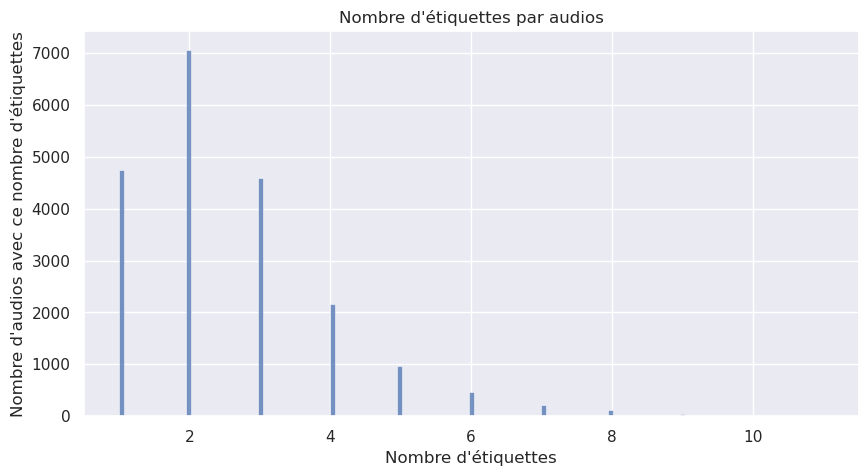

In [9]:
# À l'aide de seaborn, créez un histogramme du nombre d'étiquettes des rangées dans le DataFrame
# Pour chaque graphique ci-dessous, assurez-vous d'inclure les **noms d'axe** appropriés et un **titre**
sns.set()
plt.figure(figsize=(10, 5))
sns.histplot(df['label_count'])
plt.xlabel("Nombre d'étiquettes")
plt.ylabel("Nombre d'audios avec ce nombre d'étiquettes")
plt.title("Nombre d'étiquettes par audios")
plt.show()


Suivez les étapes ci-dessous pour créer un heatmap montrant la "corrélation" entre différentes étiquettes.
- Plus précisément, chaque cellule de la heatmap doit correspondre à la probabilité qu'un échantillon avec l'étiquette de ligne correspondante ait également l'étiquette de colonne correspondante.
- Considérez simplement les étiquettes ["Piano", "Classical music", "Speech", "Conversation", "Screaming"].

Votre graphique final devrait ressembler à ceci :

![alt text](images/heatmap.png "Heatmap")

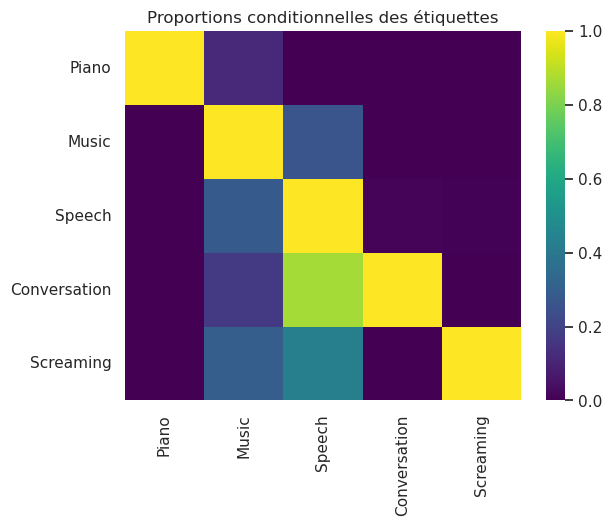

In [10]:
labels = ["Piano", "Music", "Speech", "Conversation", "Screaming"]

# Il y a plusieurs façons d'aborder cela, la façon que nous recommandons ici est de construire d'abord une grille 2D où chaque
# value est la valeur de corrélation entre la ligne/colonne correspondante à l'aide des fonctions créées dans q1.py.

grid = []
for label1 in labels:
    row = []
    for label2 in labels:
        row.append(get_conditional_proportion(df['label_names'], label1, label2))
    grid.append(row)
 

# Ensuite, à l'aide de sns.heatmap, créez la heatmap, en profitant de xticklabels et yticklabels pour définir les noms des étiquettes comme valeurs de graduation

sns.set()
sns.heatmap(grid, xticklabels=labels, yticklabels=labels, cmap="viridis")
plt.title("Proportions conditionnelles des étiquettes")
plt.show()

## Question 2
La question 2 n'a pas de composante notebook, remplissez simplement le fichier `q2.py`.

## Question 3

Téléchargez l'audio pour les étiquettes suivantes à l'aide des fonction créées dans `q3.py`

In [11]:
from q3 import data_pipeline, rename_files, filter_df

In [19]:
# Téléchargez "Cough"

data_pipeline("data/audio_segments_clean.csv", "Cough")

# Renommez les fichiers pour inclure le début et fin des échantillons ainsi que la durée

rename_files("Cough_cut", "data/audio_segments_clean.csv")

  0%|          | 0/60 [00:00<?, ?it/s]

[youtube] Extracting URL: https://www.youtube.com/watch?v=--U7joUcTCo
[youtube] --U7joUcTCo: Downloading webpage
[youtube] --U7joUcTCo: Downloading ios player API JSON
[youtube] --U7joUcTCo: Downloading android player API JSON
[youtube] --U7joUcTCo: Downloading m3u8 information
[info] --U7joUcTCo: Downloading 1 format(s): 247+251
[download] Destination: Cough_raw/--U7joUcTCo.f247.webm
[download] 100% of  601.84KiB in 00:00:00 at 2.61MiB/s     
[download] Destination: Cough_raw/--U7joUcTCo.f251.webm
[download] 100% of  114.60KiB in 00:00:00 at 943.15KiB/s 
[Merger] Merging formats into "Cough_raw/--U7joUcTCo.webm"
Deleting original file Cough_raw/--U7joUcTCo.f247.webm (pass -k to keep)
Deleting original file Cough_raw/--U7joUcTCo.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/--U7joUcTCo.mp3
Deleting original file Cough_raw/--U7joUcTCo.webm (pass -k to keep)


  2%|▏         | 1/60 [00:02<02:04,  2.11s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=0iiwZ2_9Vi8
[youtube] 0iiwZ2_9Vi8: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] 0iiwZ2_9Vi8: Downloading ios player API JSON
[youtube] 0iiwZ2_9Vi8: Downloading android player API JSON
[youtube] 0iiwZ2_9Vi8: Downloading m3u8 information
[info] 0iiwZ2_9Vi8: Downloading 1 format(s): 302+251
[download] Destination: Cough_raw/0iiwZ2_9Vi8.f302.webm
[download] 100% of   27.19MiB in 00:00:01 at 18.48MiB/s    
[download] Destination: Cough_raw/0iiwZ2_9Vi8.f251.webm
[download] 100% of    1.32MiB in 00:00:00 at 2.36MiB/s   
[Merger] Merging formats into "Cough_raw/0iiwZ2_9Vi8.webm"
Deleting original file Cough_raw/0iiwZ2_9Vi8.f302.webm (pass -k to keep)
Deleting original file Cough_raw/0iiwZ2_9Vi8.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/0iiwZ2_9Vi8.mp3
Deleting original file Cough_raw/0iiwZ2_9Vi8.webm (pass -k to keep)


  3%|▎         | 2/60 [00:06<03:25,  3.55s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=0mZQ6Q-viPw
[youtube] 0mZQ6Q-viPw: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] 0mZQ6Q-viPw: Downloading ios player API JSON
[youtube] 0mZQ6Q-viPw: Downloading android player API JSON
[youtube] 0mZQ6Q-viPw: Downloading m3u8 information
[info] 0mZQ6Q-viPw: Downloading 1 format(s): 18
[download] Destination: Cough_raw/0mZQ6Q-viPw
[download] 100% of    1.88MiB in 00:00:00 at 3.88MiB/s   
[ExtractAudio] Destination: Cough_raw/0mZQ6Q-viPw.mp3
Deleting original file Cough_raw/0mZQ6Q-viPw (pass -k to keep)


  5%|▌         | 3/60 [00:09<02:54,  3.06s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=130v5XJl8G0
[youtube] 130v5XJl8G0: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] 130v5XJl8G0: Downloading ios player API JSON
[youtube] 130v5XJl8G0: Downloading android player API JSON


ERROR: [youtube] 130v5XJl8G0: This video has been removed for violating YouTube's Terms of Service
  7%|▋         | 4/60 [00:09<01:59,  2.13s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=1Xmw9VUzvLY
[youtube] 1Xmw9VUzvLY: Downloading webpage
[youtube] 1Xmw9VUzvLY: Downloading ios player API JSON
[youtube] 1Xmw9VUzvLY: Downloading android player API JSON
[youtube] 1Xmw9VUzvLY: Downloading m3u8 information
[info] 1Xmw9VUzvLY: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/1Xmw9VUzvLY.f244.webm
[download] 100% of   11.87MiB in 00:00:00 at 14.44MiB/s    
[download] Destination: Cough_raw/1Xmw9VUzvLY.f251.webm
[download] 100% of    3.99MiB in 00:00:00 at 8.99MiB/s   
[Merger] Merging formats into "Cough_raw/1Xmw9VUzvLY.webm"
Deleting original file Cough_raw/1Xmw9VUzvLY.f244.webm (pass -k to keep)
Deleting original file Cough_raw/1Xmw9VUzvLY.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/1Xmw9VUzvLY.mp3
Deleting original file Cough_raw/1Xmw9VUzvLY.webm (pass -k to keep)


  8%|▊         | 5/60 [00:13<02:36,  2.84s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=39IZIbmQPzA
[youtube] 39IZIbmQPzA: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] 39IZIbmQPzA: Downloading ios player API JSON
[youtube] 39IZIbmQPzA: Downloading android player API JSON
[youtube] 39IZIbmQPzA: Downloading m3u8 information
[info] 39IZIbmQPzA: Downloading 1 format(s): 18
[download] Destination: Cough_raw/39IZIbmQPzA
[download] 100% of    9.89MiB in 00:00:02 at 3.59MiB/s     
[ExtractAudio] Destination: Cough_raw/39IZIbmQPzA.mp3
Deleting original file Cough_raw/39IZIbmQPzA (pass -k to keep)


 10%|█         | 6/60 [00:18<03:13,  3.58s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=3Liy9uBgsQM
[youtube] 3Liy9uBgsQM: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] 3Liy9uBgsQM: Downloading ios player API JSON
[youtube] 3Liy9uBgsQM: Downloading android player API JSON
[youtube] 3Liy9uBgsQM: Downloading m3u8 information
[info] 3Liy9uBgsQM: Downloading 1 format(s): 242+251
[download] Destination: Cough_raw/3Liy9uBgsQM.f242.webm
[download] 100% of    1.84MiB in 00:00:00 at 4.57MiB/s   
[download] Destination: Cough_raw/3Liy9uBgsQM.f251.webm
[download] 100% of    1.19MiB in 00:00:00 at 2.63MiB/s     
[Merger] Merging formats into "Cough_raw/3Liy9uBgsQM.webm"
Deleting original file Cough_raw/3Liy9uBgsQM.f242.webm (pass -k to keep)
Deleting original file Cough_raw/3Liy9uBgsQM.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/3Liy9uBgsQM.mp3
Deleting original file Cough_raw/3Liy9uBgsQM.webm (pass -k to keep)


 12%|█▏        | 7/60 [00:22<03:11,  3.61s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=3id3zRRZBVM
[youtube] 3id3zRRZBVM: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] 3id3zRRZBVM: Downloading ios player API JSON
[youtube] 3id3zRRZBVM: Downloading android player API JSON
[youtube] 3id3zRRZBVM: Downloading m3u8 information
[info] 3id3zRRZBVM: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/3id3zRRZBVM.f244.webm
[download] 100% of  157.18KiB in 00:00:00 at 649.33KiB/s 
[download] Destination: Cough_raw/3id3zRRZBVM.f251.webm
[download] 100% of    1.86MiB in 00:00:00 at 5.98MiB/s     
[Merger] Merging formats into "Cough_raw/3id3zRRZBVM.webm"
Deleting original file Cough_raw/3id3zRRZBVM.f244.webm (pass -k to keep)
Deleting original file Cough_raw/3id3zRRZBVM.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/3id3zRRZBVM.mp3
Deleting original file Cough_raw/3id3zRRZBVM.webm (pass -k to keep)


 13%|█▎        | 8/60 [00:25<02:59,  3.45s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=40fIOkLK3j4
[youtube] 40fIOkLK3j4: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] 40fIOkLK3j4: Downloading ios player API JSON
[youtube] 40fIOkLK3j4: Downloading android player API JSON
[youtube] 40fIOkLK3j4: Downloading m3u8 information
[info] 40fIOkLK3j4: Downloading 1 format(s): 313+251
[download] Destination: Cough_raw/40fIOkLK3j4.f313.webm
[download] 100% of   39.03MiB in 00:00:01 at 20.06MiB/s    
[download] Destination: Cough_raw/40fIOkLK3j4.f251.webm
[download] 100% of    2.52MiB in 00:00:00 at 9.49MiB/s     
[Merger] Merging formats into "Cough_raw/40fIOkLK3j4.webm"
Deleting original file Cough_raw/40fIOkLK3j4.f251.webm (pass -k to keep)
Deleting original file Cough_raw/40fIOkLK3j4.f313.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/40fIOkLK3j4.mp3
Deleting original file Cough_raw/40fIOkLK3j4.webm (pass -k to keep)


 15%|█▌        | 9/60 [00:31<03:34,  4.20s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=5wbc84KnDS0
[youtube] 5wbc84KnDS0: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] 5wbc84KnDS0: Downloading ios player API JSON
[youtube] 5wbc84KnDS0: Downloading android player API JSON


ERROR: [youtube] 5wbc84KnDS0: This video has been removed for violating YouTube's Terms of Service
 17%|█▋        | 10/60 [00:32<02:37,  3.14s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=7lO9BbTaezE
[youtube] 7lO9BbTaezE: Downloading webpage
[youtube] 7lO9BbTaezE: Downloading ios player API JSON
[youtube] 7lO9BbTaezE: Downloading android player API JSON


ERROR: [youtube] 7lO9BbTaezE: Private video. Sign in if you've been granted access to this video
 18%|█▊        | 11/60 [00:32<01:55,  2.37s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=9h3a7fN0f-c
[youtube] 9h3a7fN0f-c: Downloading webpage
[youtube] 9h3a7fN0f-c: Downloading ios player API JSON
[youtube] 9h3a7fN0f-c: Downloading tv embedded player API JSON
[youtube] 9h3a7fN0f-c: Downloading android player API JSON
[youtube] 9h3a7fN0f-c: Downloading android embedded player API JSON
[youtube] 9h3a7fN0f-c: Downloading web embedded client config
[youtube] 9h3a7fN0f-c: Downloading player f7e1823a
[youtube] 9h3a7fN0f-c: Downloading web embedded player API JSON
[info] 9h3a7fN0f-c: Downloading 1 format(s): 243+251
[download] Destination: Cough_raw/9h3a7fN0f-c.f243.webm
[download] 100% of    4.25MiB in 00:00:00 at 5.70MiB/s   
[download] Destination: Cough_raw/9h3a7fN0f-c.f251.webm
[download] 100% of    3.58MiB in 00:00:00 at 12.88MiB/s  
[Merger] Merging formats into "Cough_raw/9h3a7fN0f-c.webm"
Deleting original file Cough_raw/9h3a7fN0f-c.f251.webm (pass -k to keep)
Deleting original file Cough_raw/9h3a7fN0f-c.f243.we

 20%|██        | 12/60 [00:39<02:47,  3.48s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=AIVt3e5EVtc
[youtube] AIVt3e5EVtc: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] AIVt3e5EVtc: Downloading ios player API JSON
[youtube] AIVt3e5EVtc: Downloading android player API JSON
[youtube] AIVt3e5EVtc: Downloading m3u8 information
[info] AIVt3e5EVtc: Downloading 1 format(s): 247+251
[download] Destination: Cough_raw/AIVt3e5EVtc.f247.webm
[download] 100% of   15.47MiB in 00:00:01 at 9.63MiB/s   
[download] Destination: Cough_raw/AIVt3e5EVtc.f251.webm
[download] 100% of    1.02MiB in 00:00:00 at 2.69MiB/s   
[Merger] Merging formats into "Cough_raw/AIVt3e5EVtc.webm"
Deleting original file Cough_raw/AIVt3e5EVtc.f247.webm (pass -k to keep)
Deleting original file Cough_raw/AIVt3e5EVtc.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/AIVt3e5EVtc.mp3
Deleting original file Cough_raw/AIVt3e5EVtc.webm (pass -k to keep)


 22%|██▏       | 13/60 [00:43<02:59,  3.82s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=AlPu_yxLT2g
[youtube] AlPu_yxLT2g: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] AlPu_yxLT2g: Downloading ios player API JSON
[youtube] AlPu_yxLT2g: Downloading android player API JSON
[youtube] AlPu_yxLT2g: Downloading m3u8 information
[info] AlPu_yxLT2g: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/AlPu_yxLT2g.f244.webm
[download] 100% of   14.02MiB in 00:00:01 at 13.15MiB/s  
[download] Destination: Cough_raw/AlPu_yxLT2g.f251.webm
[download] 100% of    4.76MiB in 00:00:00 at 8.78MiB/s   
[Merger] Merging formats into "Cough_raw/AlPu_yxLT2g.webm"
Deleting original file Cough_raw/AlPu_yxLT2g.f244.webm (pass -k to keep)
Deleting original file Cough_raw/AlPu_yxLT2g.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/AlPu_yxLT2g.mp3
Deleting original file Cough_raw/AlPu_yxLT2g.webm (pass -k to keep)


 23%|██▎       | 14/60 [00:50<03:37,  4.72s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=BZU01hhyVKs
[youtube] BZU01hhyVKs: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] BZU01hhyVKs: Downloading ios player API JSON
[youtube] BZU01hhyVKs: Downloading android player API JSON
[youtube] BZU01hhyVKs: Downloading m3u8 information
[info] BZU01hhyVKs: Downloading 1 format(s): 243+251
[download] Destination: Cough_raw/BZU01hhyVKs.f243.webm
[download] 100% of   47.01MiB in 00:00:03 at 12.03MiB/s  
[download] Destination: Cough_raw/BZU01hhyVKs.f251.webm
[download] 100% of   19.99MiB in 00:00:01 at 10.14MiB/s    
[Merger] Merging formats into "Cough_raw/BZU01hhyVKs.webm"
Deleting original file Cough_raw/BZU01hhyVKs.f251.webm (pass -k to keep)
Deleting original file Cough_raw/BZU01hhyVKs.f243.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/BZU01hhyVKs.mp3
Deleting original file Cough_raw/BZU01hhyVKs.webm (pass -k to keep)


 25%|██▌       | 15/60 [01:07<06:16,  8.38s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=DYTLct-5tVs
[youtube] DYTLct-5tVs: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] DYTLct-5tVs: Downloading ios player API JSON
[youtube] DYTLct-5tVs: Downloading android player API JSON
[youtube] DYTLct-5tVs: Downloading m3u8 information
[info] DYTLct-5tVs: Downloading 1 format(s): 247+251
[download] Destination: Cough_raw/DYTLct-5tVs.f247.webm
[download] 100% of    5.15MiB in 00:00:00 at 12.01MiB/s  
[download] Destination: Cough_raw/DYTLct-5tVs.f251.webm
[download] 100% of  654.25KiB in 00:00:00 at 2.89MiB/s   
[Merger] Merging formats into "Cough_raw/DYTLct-5tVs.webm"
Deleting original file Cough_raw/DYTLct-5tVs.f251.webm (pass -k to keep)
Deleting original file Cough_raw/DYTLct-5tVs.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/DYTLct-5tVs.mp3
Deleting original file Cough_raw/DYTLct-5tVs.webm (pass -k to keep)


 27%|██▋       | 16/60 [01:10<04:54,  6.69s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=HJg4jZNv1pc
[youtube] HJg4jZNv1pc: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] HJg4jZNv1pc: Downloading ios player API JSON
[youtube] HJg4jZNv1pc: Downloading android player API JSON


ERROR: [youtube] HJg4jZNv1pc: Private video. Sign in if you've been granted access to this video
 28%|██▊       | 17/60 [01:10<03:31,  4.91s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=HMnF8n9c5-Y
[youtube] HMnF8n9c5-Y: Downloading webpage
[youtube] HMnF8n9c5-Y: Downloading ios player API JSON
[youtube] HMnF8n9c5-Y: Downloading android player API JSON
[youtube] HMnF8n9c5-Y: Downloading m3u8 information
[info] HMnF8n9c5-Y: Downloading 1 format(s): 248+258
[download] Destination: Cough_raw/HMnF8n9c5-Y.f248.webm
[download] 100% of   38.65MiB in 00:00:01 at 20.40MiB/s  
[download] Destination: Cough_raw/HMnF8n9c5-Y.f258.m4a
[download] 100% of    7.66MiB in 00:00:00 at 11.41MiB/s  
[Merger] Merging formats into "Cough_raw/HMnF8n9c5-Y.mkv"
Deleting original file Cough_raw/HMnF8n9c5-Y.f248.webm (pass -k to keep)
Deleting original file Cough_raw/HMnF8n9c5-Y.f258.m4a (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/HMnF8n9c5-Y.mp3
Deleting original file Cough_raw/HMnF8n9c5-Y.mkv (pass -k to keep)


 30%|███       | 18/60 [01:16<03:42,  5.29s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=IYllzXfvkmY
[youtube] IYllzXfvkmY: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] IYllzXfvkmY: Downloading ios player API JSON
[youtube] IYllzXfvkmY: Downloading android player API JSON
[youtube] IYllzXfvkmY: Downloading m3u8 information
[info] IYllzXfvkmY: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/IYllzXfvkmY.f244.webm
[download] 100% of    3.14MiB in 00:00:00 at 8.90MiB/s   
[download] Destination: Cough_raw/IYllzXfvkmY.f251.webm
[download] 100% of  698.02KiB in 00:00:00 at 1.98MiB/s   
[Merger] Merging formats into "Cough_raw/IYllzXfvkmY.webm"
Deleting original file Cough_raw/IYllzXfvkmY.f244.webm (pass -k to keep)
Deleting original file Cough_raw/IYllzXfvkmY.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/IYllzXfvkmY.mp3
Deleting original file Cough_raw/IYllzXfvkmY.webm (pass -k to keep)


 32%|███▏      | 19/60 [01:19<03:04,  4.49s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=IwQFUAPEk70
[youtube] IwQFUAPEk70: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] IwQFUAPEk70: Downloading ios player API JSON
[youtube] IwQFUAPEk70: Downloading android player API JSON


ERROR: [youtube] IwQFUAPEk70: Private video. Sign in if you've been granted access to this video
 33%|███▎      | 20/60 [01:20<02:14,  3.37s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=IzPMbIll3LE
[youtube] IzPMbIll3LE: Downloading webpage
[youtube] IzPMbIll3LE: Downloading ios player API JSON
[youtube] IzPMbIll3LE: Downloading android player API JSON
[youtube] IzPMbIll3LE: Downloading m3u8 information
[info] IzPMbIll3LE: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/IzPMbIll3LE.f244.webm
[download] 100% of  629.33KiB in 00:00:00 at 1.71MiB/s   
[download] Destination: Cough_raw/IzPMbIll3LE.f251.webm
[download] 100% of    1.10MiB in 00:00:00 at 1.63MiB/s   
[Merger] Merging formats into "Cough_raw/IzPMbIll3LE.webm"
Deleting original file Cough_raw/IzPMbIll3LE.f244.webm (pass -k to keep)
Deleting original file Cough_raw/IzPMbIll3LE.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/IzPMbIll3LE.mp3
Deleting original file Cough_raw/IzPMbIll3LE.webm (pass -k to keep)


 35%|███▌      | 21/60 [01:23<02:07,  3.27s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=JKUSKYdYo9w
[youtube] JKUSKYdYo9w: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] JKUSKYdYo9w: Downloading ios player API JSON
[youtube] JKUSKYdYo9w: Downloading android player API JSON
[youtube] JKUSKYdYo9w: Downloading m3u8 information
[info] JKUSKYdYo9w: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/JKUSKYdYo9w.f244.webm
[download] 100% of    2.23MiB in 00:00:00 at 4.26MiB/s   
[download] Destination: Cough_raw/JKUSKYdYo9w.f251.webm
[download] 100% of  838.30KiB in 00:00:00 at 1.99MiB/s   
[Merger] Merging formats into "Cough_raw/JKUSKYdYo9w.webm"
Deleting original file Cough_raw/JKUSKYdYo9w.f244.webm (pass -k to keep)
Deleting original file Cough_raw/JKUSKYdYo9w.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/JKUSKYdYo9w.mp3
Deleting original file Cough_raw/JKUSKYdYo9w.webm (pass -k to keep)


 37%|███▋      | 22/60 [01:26<02:07,  3.35s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=JLtieDCSa6Y
[youtube] JLtieDCSa6Y: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] JLtieDCSa6Y: Downloading ios player API JSON
[youtube] JLtieDCSa6Y: Downloading android player API JSON
[youtube] JLtieDCSa6Y: Downloading m3u8 information
[youtube] JLtieDCSa6Y: Downloading MPD manifest
[info] JLtieDCSa6Y: Downloading 1 format(s): 248+140
[dashsegments] Total fragments: 8
[download] Destination: Cough_raw/JLtieDCSa6Y.f248.webm
[download] 100% of    5.78MiB in 00:00:02 at 2.62MiB/s               
[download] Destination: Cough_raw/JLtieDCSa6Y.f140.m4a
[download] 100% of  565.48KiB in 00:00:00 at 1.99MiB/s   
[Merger] Merging formats into "Cough_raw/JLtieDCSa6Y.mkv"
Deleting original file Cough_raw/JLtieDCSa6Y.f248.webm (pass -k to keep)
Deleting original file Cough_raw/JLtieDCSa6Y.f140.m4a (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/JLtieDCSa6Y.mp3
Deleting original file Cough_raw/JLtieDCSa6Y.mkv (pass -k to keep)


 38%|███▊      | 23/60 [01:31<02:15,  3.67s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=Kqt4BiLQeeI
[youtube] Kqt4BiLQeeI: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Kqt4BiLQeeI: Downloading ios player API JSON
[youtube] Kqt4BiLQeeI: Downloading android player API JSON
[youtube] Kqt4BiLQeeI: Downloading m3u8 information
[info] Kqt4BiLQeeI: Downloading 1 format(s): 247+251
[download] Destination: Cough_raw/Kqt4BiLQeeI.f247.webm
[download] 100% of  268.95MiB in 00:00:17 at 15.72MiB/s    
[download] Destination: Cough_raw/Kqt4BiLQeeI.f251.webm
[download] 100% of   33.31MiB in 00:00:01 at 18.93MiB/s    
[Merger] Merging formats into "Cough_raw/Kqt4BiLQeeI.webm"
Deleting original file Cough_raw/Kqt4BiLQeeI.f251.webm (pass -k to keep)
Deleting original file Cough_raw/Kqt4BiLQeeI.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/Kqt4BiLQeeI.mp3
Deleting original file Cough_raw/Kqt4BiLQeeI.webm (pass -k to keep)


 40%|████      | 24/60 [02:10<08:33, 14.27s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=MVLEz28ZdFU
[youtube] MVLEz28ZdFU: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] MVLEz28ZdFU: Downloading ios player API JSON
[youtube] MVLEz28ZdFU: Downloading android player API JSON
[youtube] MVLEz28ZdFU: Downloading m3u8 information
[info] MVLEz28ZdFU: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/MVLEz28ZdFU.f244.webm
[download] 100% of   27.25MiB in 00:00:01 at 17.23MiB/s    
[download] Destination: Cough_raw/MVLEz28ZdFU.f251.webm
[download] 100% of    5.41MiB in 00:00:00 at 12.48MiB/s    
[Merger] Merging formats into "Cough_raw/MVLEz28ZdFU.webm"
Deleting original file Cough_raw/MVLEz28ZdFU.f251.webm (pass -k to keep)
Deleting original file Cough_raw/MVLEz28ZdFU.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/MVLEz28ZdFU.mp3
Deleting original file Cough_raw/MVLEz28ZdFU.webm (pass -k to keep)


 42%|████▏     | 25/60 [02:16<06:57, 11.93s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=NjazulpHxNY
[youtube] NjazulpHxNY: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] NjazulpHxNY: Downloading ios player API JSON
[youtube] NjazulpHxNY: Downloading android player API JSON
[youtube] NjazulpHxNY: Downloading m3u8 information
[info] NjazulpHxNY: Downloading 1 format(s): 313+140
[download] Destination: Cough_raw/NjazulpHxNY.f313.webm
[download] 100% of   59.50MiB in 00:00:03 at 16.82MiB/s    
[download] Destination: Cough_raw/NjazulpHxNY.f140.m4a
[download] 100% of    1.77MiB in 00:00:00 at 2.70MiB/s   
[Merger] Merging formats into "Cough_raw/NjazulpHxNY.mkv"
Deleting original file Cough_raw/NjazulpHxNY.f140.m4a (pass -k to keep)
Deleting original file Cough_raw/NjazulpHxNY.f313.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/NjazulpHxNY.mp3
Deleting original file Cough_raw/NjazulpHxNY.mkv (pass -k to keep)


 43%|████▎     | 26/60 [02:23<05:54, 10.41s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=OSlYn9hTRFA
[youtube] OSlYn9hTRFA: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] OSlYn9hTRFA: Downloading ios player API JSON
[youtube] OSlYn9hTRFA: Downloading android player API JSON
[youtube] OSlYn9hTRFA: Downloading m3u8 information
[info] OSlYn9hTRFA: Downloading 1 format(s): 313+251
[download] Destination: Cough_raw/OSlYn9hTRFA.f313.webm
[download] 100% of   84.64MiB in 00:00:07 at 11.91MiB/s  
[download] Destination: Cough_raw/OSlYn9hTRFA.f251.webm
[download] 100% of  974.67KiB in 00:00:00 at 4.07MiB/s   
[Merger] Merging formats into "Cough_raw/OSlYn9hTRFA.webm"
Deleting original file Cough_raw/OSlYn9hTRFA.f313.webm (pass -k to keep)
Deleting original file Cough_raw/OSlYn9hTRFA.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/OSlYn9hTRFA.mp3
Deleting original file Cough_raw/OSlYn9hTRFA.webm (pass -k to keep)


 45%|████▌     | 27/60 [02:33<05:37, 10.24s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=OwAUGABGrqk
[youtube] OwAUGABGrqk: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] OwAUGABGrqk: Downloading ios player API JSON
[youtube] OwAUGABGrqk: Downloading android player API JSON
[youtube] OwAUGABGrqk: Downloading m3u8 information
[info] OwAUGABGrqk: Downloading 1 format(s): 248+251
[download] Destination: Cough_raw/OwAUGABGrqk.f248.webm
[download] 100% of   43.76MiB in 00:00:02 at 17.18MiB/s    
[download] Destination: Cough_raw/OwAUGABGrqk.f251.webm
[download] 100% of    3.53MiB in 00:00:00 at 8.38MiB/s     
[Merger] Merging formats into "Cough_raw/OwAUGABGrqk.webm"
Deleting original file Cough_raw/OwAUGABGrqk.f248.webm (pass -k to keep)
Deleting original file Cough_raw/OwAUGABGrqk.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/OwAUGABGrqk.mp3
Deleting original file Cough_raw/OwAUGABGrqk.webm (pass -k to keep)


 47%|████▋     | 28/60 [02:40<04:59,  9.35s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=PyXQVNaAbHc
[youtube] PyXQVNaAbHc: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] PyXQVNaAbHc: Downloading ios player API JSON
[youtube] PyXQVNaAbHc: Downloading android player API JSON
[youtube] PyXQVNaAbHc: Downloading m3u8 information
[youtube] PyXQVNaAbHc: Downloading MPD manifest
[info] PyXQVNaAbHc: Downloading 1 format(s): 242+251
[dashsegments] Total fragments: 11
[download] Destination: Cough_raw/PyXQVNaAbHc.f242.webm
[download] 100% of  963.67KiB in 00:00:02 at 456.82KiB/s               
[download] Destination: Cough_raw/PyXQVNaAbHc.f251.webm
[download] 100% of  826.74KiB in 00:00:00 at 2.75MiB/s   
[Merger] Merging formats into "Cough_raw/PyXQVNaAbHc.webm"
Deleting original file Cough_raw/PyXQVNaAbHc.f251.webm (pass -k to keep)
Deleting original file Cough_raw/PyXQVNaAbHc.f242.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/PyXQVNaAbHc.mp3
Deleting original file Cough_raw/PyXQVNaAbHc.webm (pass -k to keep)


 48%|████▊     | 29/60 [02:45<04:07,  7.97s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=RFeU64gTvGQ
[youtube] RFeU64gTvGQ: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] RFeU64gTvGQ: Downloading ios player API JSON
[youtube] RFeU64gTvGQ: Downloading android player API JSON
[youtube] RFeU64gTvGQ: Downloading m3u8 information
[info] RFeU64gTvGQ: Downloading 1 format(s): 247+140
[download] Destination: Cough_raw/RFeU64gTvGQ.f247.webm
[download] 100% of  567.93KiB in 00:00:00 at 2.39MiB/s     
[download] Destination: Cough_raw/RFeU64gTvGQ.f140.m4a
[download] 100% of  146.35KiB in 00:00:00 at 335.31KiB/s 
[Merger] Merging formats into "Cough_raw/RFeU64gTvGQ.mkv"
Deleting original file Cough_raw/RFeU64gTvGQ.f140.m4a (pass -k to keep)
Deleting original file Cough_raw/RFeU64gTvGQ.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/RFeU64gTvGQ.mp3
Deleting original file Cough_raw/RFeU64gTvGQ.mkv (pass -k to keep)


 50%|█████     | 30/60 [02:47<03:07,  6.26s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=RXJxtAHtkcs
[youtube] RXJxtAHtkcs: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] RXJxtAHtkcs: Downloading ios player API JSON
[youtube] RXJxtAHtkcs: Downloading android player API JSON
[youtube] RXJxtAHtkcs: Downloading m3u8 information
[info] RXJxtAHtkcs: Downloading 1 format(s): 247+251
[download] Destination: Cough_raw/RXJxtAHtkcs.f247.webm
[download] 100% of  868.55KiB in 00:00:00 at 3.20MiB/s   
[download] Destination: Cough_raw/RXJxtAHtkcs.f251.webm
[download] 100% of  682.47KiB in 00:00:00 at 2.24MiB/s     
[Merger] Merging formats into "Cough_raw/RXJxtAHtkcs.webm"
Deleting original file Cough_raw/RXJxtAHtkcs.f247.webm (pass -k to keep)
Deleting original file Cough_raw/RXJxtAHtkcs.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/RXJxtAHtkcs.mp3
Deleting original file Cough_raw/RXJxtAHtkcs.webm (pass -k to keep)


 52%|█████▏    | 31/60 [02:50<02:29,  5.15s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=Rr84-EZvO0U
[youtube] Rr84-EZvO0U: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Rr84-EZvO0U: Downloading ios player API JSON
[youtube] Rr84-EZvO0U: Downloading android player API JSON
[youtube] Rr84-EZvO0U: Downloading m3u8 information
[info] Rr84-EZvO0U: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/Rr84-EZvO0U.f244.webm
[download] 100% of    3.34MiB in 00:00:00 at 3.94MiB/s   
[download] Destination: Cough_raw/Rr84-EZvO0U.f251.webm
[download] 100% of  894.48KiB in 00:00:00 at 3.54MiB/s   
[Merger] Merging formats into "Cough_raw/Rr84-EZvO0U.webm"
Deleting original file Cough_raw/Rr84-EZvO0U.f251.webm (pass -k to keep)
Deleting original file Cough_raw/Rr84-EZvO0U.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/Rr84-EZvO0U.mp3
Deleting original file Cough_raw/Rr84-EZvO0U.webm (pass -k to keep)


 53%|█████▎    | 32/60 [02:53<02:07,  4.56s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=Rtg1SUrxOPY
[youtube] Rtg1SUrxOPY: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Rtg1SUrxOPY: Downloading ios player API JSON
[youtube] Rtg1SUrxOPY: Downloading android player API JSON
[youtube] Rtg1SUrxOPY: Downloading m3u8 information
[youtube] Rtg1SUrxOPY: Downloading MPD manifest
[info] Rtg1SUrxOPY: Downloading 1 format(s): 248+140
[dashsegments] Total fragments: 31
[download] Destination: Cough_raw/Rtg1SUrxOPY.f248.webm
[download] 100% of   31.04MiB in 00:00:08 at 3.57MiB/s                   
[download] Destination: Cough_raw/Rtg1SUrxOPY.f140.m4a
[download] 100% of    2.29MiB in 00:00:00 at 6.97MiB/s   
[Merger] Merging formats into "Cough_raw/Rtg1SUrxOPY.mkv"
Deleting original file Cough_raw/Rtg1SUrxOPY.f140.m4a (pass -k to keep)
Deleting original file Cough_raw/Rtg1SUrxOPY.f248.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/Rtg1SUrxOPY.mp3
Deleting original file Cough_raw/Rtg1SUrxOPY.mkv (pass -k to keep)


 55%|█████▌    | 33/60 [03:05<03:04,  6.82s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=S3oZrMGDMMw
[youtube] S3oZrMGDMMw: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] S3oZrMGDMMw: Downloading ios player API JSON
[youtube] S3oZrMGDMMw: Downloading android player API JSON
[youtube] S3oZrMGDMMw: Downloading m3u8 information
[info] S3oZrMGDMMw: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/S3oZrMGDMMw.f244.webm
[download] 100% of    7.42MiB in 00:00:00 at 14.39MiB/s  
[download] Destination: Cough_raw/S3oZrMGDMMw.f251.webm
[download] 100% of    2.25MiB in 00:00:00 at 7.03MiB/s     
[Merger] Merging formats into "Cough_raw/S3oZrMGDMMw.webm"
Deleting original file Cough_raw/S3oZrMGDMMw.f251.webm (pass -k to keep)
Deleting original file Cough_raw/S3oZrMGDMMw.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/S3oZrMGDMMw.mp3
Deleting original file Cough_raw/S3oZrMGDMMw.webm (pass -k to keep)


 57%|█████▋    | 34/60 [03:09<02:31,  5.83s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=TA-iHSeEUYk
[youtube] TA-iHSeEUYk: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] TA-iHSeEUYk: Downloading ios player API JSON
[youtube] TA-iHSeEUYk: Downloading android player API JSON
[youtube] TA-iHSeEUYk: Downloading m3u8 information
[info] TA-iHSeEUYk: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/TA-iHSeEUYk.f244.webm
[download] 100% of  172.91KiB in 00:00:00 at 445.41KiB/s 
[download] Destination: Cough_raw/TA-iHSeEUYk.f251.webm
[download] 100% of    1.78MiB in 00:00:00 at 7.01MiB/s   
[Merger] Merging formats into "Cough_raw/TA-iHSeEUYk.webm"
Deleting original file Cough_raw/TA-iHSeEUYk.f251.webm (pass -k to keep)
Deleting original file Cough_raw/TA-iHSeEUYk.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/TA-iHSeEUYk.mp3
Deleting original file Cough_raw/TA-iHSeEUYk.webm (pass -k to keep)


 58%|█████▊    | 35/60 [03:12<02:03,  4.96s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=TB3VhNczX88
[youtube] TB3VhNczX88: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] TB3VhNczX88: Downloading ios player API JSON
[youtube] TB3VhNczX88: Downloading android player API JSON
[youtube] TB3VhNczX88: Downloading m3u8 information
[info] TB3VhNczX88: Downloading 1 format(s): 397+251
[download] Destination: Cough_raw/TB3VhNczX88.f397.mp4
[download] 100% of    1.48MiB in 00:00:00 at 5.67MiB/s   
[download] Destination: Cough_raw/TB3VhNczX88.f251.webm
[download] 100% of  863.26KiB in 00:00:00 at 2.72MiB/s     
[Merger] Merging formats into "Cough_raw/TB3VhNczX88.webm"
Deleting original file Cough_raw/TB3VhNczX88.f251.webm (pass -k to keep)
Deleting original file Cough_raw/TB3VhNczX88.f397.mp4 (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/TB3VhNczX88.mp3
Deleting original file Cough_raw/TB3VhNczX88.webm (pass -k to keep)


 60%|██████    | 36/60 [03:14<01:42,  4.28s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=ThHs0zNnQXg
[youtube] ThHs0zNnQXg: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] ThHs0zNnQXg: Downloading ios player API JSON
[youtube] ThHs0zNnQXg: Downloading android player API JSON


ERROR: [youtube] ThHs0zNnQXg: This video has been removed for violating YouTube's policy on nudity or sexual content
 62%|██████▏   | 37/60 [03:15<01:13,  3.19s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=TjP-9AlPShg
[youtube] TjP-9AlPShg: Downloading webpage
[youtube] TjP-9AlPShg: Downloading ios player API JSON
[youtube] TjP-9AlPShg: Downloading android player API JSON
[youtube] TjP-9AlPShg: Downloading m3u8 information
[info] TjP-9AlPShg: Downloading 1 format(s): 242+140
[download] Destination: Cough_raw/TjP-9AlPShg.f242.webm
[download] 100% of    2.09MiB in 00:00:00 at 2.94MiB/s     
[download] Destination: Cough_raw/TjP-9AlPShg.f140.m4a
[download] 100% of    2.31MiB in 00:00:00 at 4.11MiB/s     
[Merger] Merging formats into "Cough_raw/TjP-9AlPShg.mkv"
Deleting original file Cough_raw/TjP-9AlPShg.f140.m4a (pass -k to keep)
Deleting original file Cough_raw/TjP-9AlPShg.f242.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/TjP-9AlPShg.mp3
Deleting original file Cough_raw/TjP-9AlPShg.mkv (pass -k to keep)


 63%|██████▎   | 38/60 [03:19<01:14,  3.38s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=X8yUSV4oqoU
[youtube] X8yUSV4oqoU: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] X8yUSV4oqoU: Downloading ios player API JSON
[youtube] X8yUSV4oqoU: Downloading android player API JSON
[youtube] X8yUSV4oqoU: Downloading m3u8 information
[info] X8yUSV4oqoU: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/X8yUSV4oqoU.f244.webm
[download] 100% of    3.92MiB in 00:00:00 at 10.04MiB/s  
[download] Destination: Cough_raw/X8yUSV4oqoU.f251.webm
[download] 100% of    2.01MiB in 00:00:00 at 4.98MiB/s     
[Merger] Merging formats into "Cough_raw/X8yUSV4oqoU.webm"
Deleting original file Cough_raw/X8yUSV4oqoU.f244.webm (pass -k to keep)
Deleting original file Cough_raw/X8yUSV4oqoU.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/X8yUSV4oqoU.mp3
Deleting original file Cough_raw/X8yUSV4oqoU.webm (pass -k to keep)


 65%|██████▌   | 39/60 [03:23<01:17,  3.69s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=YsUCzO0gfro
[youtube] YsUCzO0gfro: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] YsUCzO0gfro: Downloading ios player API JSON
[youtube] YsUCzO0gfro: Downloading android player API JSON
[youtube] YsUCzO0gfro: Downloading m3u8 information
[info] YsUCzO0gfro: Downloading 1 format(s): 18
[download] Destination: Cough_raw/YsUCzO0gfro
[download] 100% of    6.58MiB in 00:00:00 at 10.40MiB/s  
[ExtractAudio] Destination: Cough_raw/YsUCzO0gfro.mp3
Deleting original file Cough_raw/YsUCzO0gfro (pass -k to keep)


 67%|██████▋   | 40/60 [03:26<01:11,  3.56s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=_-_5kbw2Mcw
[youtube] _-_5kbw2Mcw: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] _-_5kbw2Mcw: Downloading ios player API JSON
[youtube] _-_5kbw2Mcw: Downloading android player API JSON
[youtube] _-_5kbw2Mcw: Downloading m3u8 information
[info] _-_5kbw2Mcw: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/_-_5kbw2Mcw.f244.webm
[download] 100% of    3.92MiB in 00:00:00 at 8.85MiB/s   
[download] Destination: Cough_raw/_-_5kbw2Mcw.f251.webm
[download] 100% of    1.49MiB in 00:00:00 at 4.89MiB/s     
[Merger] Merging formats into "Cough_raw/_-_5kbw2Mcw.webm"
Deleting original file Cough_raw/_-_5kbw2Mcw.f244.webm (pass -k to keep)
Deleting original file Cough_raw/_-_5kbw2Mcw.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/_-_5kbw2Mcw.mp3
Deleting original file Cough_raw/_-_5kbw2Mcw.webm (pass -k to keep)


 68%|██████▊   | 41/60 [03:30<01:07,  3.55s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=_prGJ06oCXk
[youtube] _prGJ06oCXk: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] _prGJ06oCXk: Downloading ios player API JSON
[youtube] _prGJ06oCXk: Downloading android player API JSON


ERROR: [youtube] _prGJ06oCXk: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
 70%|███████   | 42/60 [03:31<00:48,  2.70s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=aFfXpjfI2nk
[youtube] aFfXpjfI2nk: Downloading webpage
[youtube] aFfXpjfI2nk: Downloading ios player API JSON
[youtube] aFfXpjfI2nk: Downloading android player API JSON


ERROR: [youtube] aFfXpjfI2nk: This video has been removed for violating YouTube's Terms of Service
 72%|███████▏  | 43/60 [03:31<00:35,  2.09s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=fIer0uCLqSM
[youtube] fIer0uCLqSM: Downloading webpage
[youtube] fIer0uCLqSM: Downloading ios player API JSON
[youtube] fIer0uCLqSM: Downloading android player API JSON
[youtube] fIer0uCLqSM: Downloading m3u8 information
[youtube] fIer0uCLqSM: Downloading MPD manifest
[info] fIer0uCLqSM: Downloading 1 format(s): 242+140
[dashsegments] Total fragments: 10
[download] Destination: Cough_raw/fIer0uCLqSM.f242.webm
[download] 100% of  716.44KiB in 00:00:01 at 405.34KiB/s               
[download] Destination: Cough_raw/fIer0uCLqSM.f140.m4a
[download] 100% of  511.25KiB in 00:00:00 at 2.30MiB/s     
[Merger] Merging formats into "Cough_raw/fIer0uCLqSM.mkv"
Deleting original file Cough_raw/fIer0uCLqSM.f140.m4a (pass -k to keep)
Deleting original file Cough_raw/fIer0uCLqSM.f242.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/fIer0uCLqSM.mp3
Deleting original file Cough_raw/fIer0uCLqSM.mkv (pass -k to keep)


 73%|███████▎  | 44/60 [03:35<00:42,  2.64s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=hQMkT2YEnNA
[youtube] hQMkT2YEnNA: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] hQMkT2YEnNA: Downloading ios player API JSON
[youtube] hQMkT2YEnNA: Downloading android player API JSON


ERROR: [youtube] hQMkT2YEnNA: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
 75%|███████▌  | 45/60 [03:36<00:30,  2.02s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=iUtE4nRvBsM
[youtube] iUtE4nRvBsM: Downloading webpage
[youtube] iUtE4nRvBsM: Downloading ios player API JSON
[youtube] iUtE4nRvBsM: Downloading android player API JSON
[youtube] iUtE4nRvBsM: Downloading m3u8 information
[info] iUtE4nRvBsM: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/iUtE4nRvBsM.f244.webm
[download] 100% of    6.78MiB in 00:00:00 at 7.87MiB/s   
[download] Destination: Cough_raw/iUtE4nRvBsM.f251.webm
[download] 100% of    1.50MiB in 00:00:00 at 4.29MiB/s     
[Merger] Merging formats into "Cough_raw/iUtE4nRvBsM.webm"
Deleting original file Cough_raw/iUtE4nRvBsM.f251.webm (pass -k to keep)
Deleting original file Cough_raw/iUtE4nRvBsM.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/iUtE4nRvBsM.mp3
Deleting original file Cough_raw/iUtE4nRvBsM.webm (pass -k to keep)


 77%|███████▋  | 46/60 [03:39<00:35,  2.50s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=j6gaw7Nasnc
[youtube] j6gaw7Nasnc: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] j6gaw7Nasnc: Downloading ios player API JSON
[youtube] j6gaw7Nasnc: Downloading android player API JSON


ERROR: [youtube] j6gaw7Nasnc: Private video. Sign in if you've been granted access to this video
 78%|███████▊  | 47/60 [03:40<00:25,  1.95s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=kL_-XdzJQ3g
[youtube] kL_-XdzJQ3g: Downloading webpage
[youtube] kL_-XdzJQ3g: Downloading ios player API JSON
[youtube] kL_-XdzJQ3g: Downloading android player API JSON


ERROR: [youtube] kL_-XdzJQ3g: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
 80%|████████  | 48/60 [03:41<00:18,  1.58s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=kOheqjodDmw
[youtube] kOheqjodDmw: Downloading webpage
[youtube] kOheqjodDmw: Downloading ios player API JSON
[youtube] kOheqjodDmw: Downloading android player API JSON
[youtube] kOheqjodDmw: Downloading m3u8 information
[info] kOheqjodDmw: Downloading 1 format(s): 303+251
[download] Destination: Cough_raw/kOheqjodDmw.f303.webm
[download] 100% of  109.27MiB in 00:00:05 at 18.98MiB/s    
[download] Destination: Cough_raw/kOheqjodDmw.f251.webm
[download] 100% of    3.74MiB in 00:00:00 at 9.49MiB/s   
[Merger] Merging formats into "Cough_raw/kOheqjodDmw.webm"
Deleting original file Cough_raw/kOheqjodDmw.f251.webm (pass -k to keep)
Deleting original file Cough_raw/kOheqjodDmw.f303.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/kOheqjodDmw.mp3
Deleting original file Cough_raw/kOheqjodDmw.webm (pass -k to keep)


 82%|████████▏ | 49/60 [03:52<00:48,  4.39s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=khC7ed0_Kvs
[youtube] khC7ed0_Kvs: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] khC7ed0_Kvs: Downloading ios player API JSON
[youtube] khC7ed0_Kvs: Downloading android player API JSON


ERROR: [youtube] khC7ed0_Kvs: Video unavailable
 83%|████████▎ | 50/60 [03:53<00:32,  3.30s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=lH6ym1UrlnE
[youtube] lH6ym1UrlnE: Downloading webpage
[youtube] lH6ym1UrlnE: Downloading ios player API JSON
[youtube] lH6ym1UrlnE: Downloading android player API JSON
[youtube] lH6ym1UrlnE: Downloading m3u8 information
[info] lH6ym1UrlnE: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/lH6ym1UrlnE.f244.webm
[download] 100% of  136.87KiB in 00:00:00 at 797.46KiB/s 
[download] Destination: Cough_raw/lH6ym1UrlnE.f251.webm
[download] 100% of    1.36MiB in 00:00:00 at 2.96MiB/s   
[Merger] Merging formats into "Cough_raw/lH6ym1UrlnE.webm"
Deleting original file Cough_raw/lH6ym1UrlnE.f251.webm (pass -k to keep)
Deleting original file Cough_raw/lH6ym1UrlnE.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/lH6ym1UrlnE.mp3
Deleting original file Cough_raw/lH6ym1UrlnE.webm (pass -k to keep)


 85%|████████▌ | 51/60 [03:56<00:29,  3.24s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=mQITX62D_3s
[youtube] mQITX62D_3s: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] mQITX62D_3s: Downloading ios player API JSON
[youtube] mQITX62D_3s: Downloading android player API JSON


ERROR: [youtube] mQITX62D_3s: Video unavailable
 87%|████████▋ | 52/60 [03:56<00:19,  2.45s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=nBuw_KZXT_k
[youtube] nBuw_KZXT_k: Downloading webpage
[youtube] nBuw_KZXT_k: Downloading ios player API JSON
[youtube] nBuw_KZXT_k: Downloading android player API JSON
[youtube] nBuw_KZXT_k: Downloading m3u8 information
[info] nBuw_KZXT_k: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/nBuw_KZXT_k.f244.webm
[download] 100% of   50.07KiB in 00:00:00 at 133.16KiB/s 
[download] Destination: Cough_raw/nBuw_KZXT_k.f251.webm
[download] 100% of  313.87KiB in 00:00:00 at 927.21KiB/s 
[Merger] Merging formats into "Cough_raw/nBuw_KZXT_k.webm"
Deleting original file Cough_raw/nBuw_KZXT_k.f251.webm (pass -k to keep)
Deleting original file Cough_raw/nBuw_KZXT_k.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/nBuw_KZXT_k.mp3
Deleting original file Cough_raw/nBuw_KZXT_k.webm (pass -k to keep)


 88%|████████▊ | 53/60 [03:59<00:18,  2.58s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=nK04u0NuenA
[youtube] nK04u0NuenA: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] nK04u0NuenA: Downloading ios player API JSON
[youtube] nK04u0NuenA: Downloading android player API JSON


ERROR: [youtube] nK04u0NuenA: This video has been removed for violating YouTube's Community Guidelines
 90%|█████████ | 54/60 [04:00<00:12,  2.01s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=pzsV0Sr5hrE
[youtube] pzsV0Sr5hrE: Downloading webpage
[youtube] pzsV0Sr5hrE: Downloading ios player API JSON
[youtube] pzsV0Sr5hrE: Downloading android player API JSON
[youtube] pzsV0Sr5hrE: Downloading m3u8 information
[info] pzsV0Sr5hrE: Downloading 1 format(s): 135+140
[download] Destination: Cough_raw/pzsV0Sr5hrE.f135.mp4
[download] 100% of    2.90MiB in 00:00:09 at 308.60KiB/s 
[download] Destination: Cough_raw/pzsV0Sr5hrE.f140.m4a
[download] 100% of  502.77KiB in 00:00:00 at 1.80MiB/s   
[Merger] Merging formats into "Cough_raw/pzsV0Sr5hrE.mp4"
Deleting original file Cough_raw/pzsV0Sr5hrE.f140.m4a (pass -k to keep)
Deleting original file Cough_raw/pzsV0Sr5hrE.f135.mp4 (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/pzsV0Sr5hrE.mp3
Deleting original file Cough_raw/pzsV0Sr5hrE.mp4 (pass -k to keep)


 92%|█████████▏| 55/60 [04:12<00:25,  5.01s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=vIBtwK5mH5Q
[youtube] vIBtwK5mH5Q: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] vIBtwK5mH5Q: Downloading ios player API JSON
[youtube] vIBtwK5mH5Q: Downloading android player API JSON


ERROR: [youtube] vIBtwK5mH5Q: This video has been removed for violating YouTube's Community Guidelines
 93%|█████████▎| 56/60 [04:12<00:14,  3.69s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=w4enmhllLkQ
[youtube] w4enmhllLkQ: Downloading webpage
[youtube] w4enmhllLkQ: Downloading ios player API JSON
[youtube] w4enmhllLkQ: Downloading android player API JSON


ERROR: [youtube] w4enmhllLkQ: This video has been removed for violating YouTube's Terms of Service
 95%|█████████▌| 57/60 [04:13<00:08,  2.78s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=wU1xLUAWAyA
[youtube] wU1xLUAWAyA: Downloading webpage
[youtube] wU1xLUAWAyA: Downloading ios player API JSON
[youtube] wU1xLUAWAyA: Downloading android player API JSON


ERROR: [youtube] wU1xLUAWAyA: Video unavailable. This video is no longer available because the YouTube account associated with this video has been terminated.
 97%|█████████▋| 58/60 [04:14<00:04,  2.14s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=wuvn-vp5InE
[youtube] wuvn-vp5InE: Downloading webpage
[youtube] wuvn-vp5InE: Downloading ios player API JSON
[youtube] wuvn-vp5InE: Downloading android player API JSON
[youtube] wuvn-vp5InE: Downloading m3u8 information
[info] wuvn-vp5InE: Downloading 1 format(s): 242+251
[download] Destination: Cough_raw/wuvn-vp5InE.f242.webm
[download] 100% of  128.04KiB in 00:00:00 at 533.86KiB/s 
[download] Destination: Cough_raw/wuvn-vp5InE.f251.webm
[download] 100% of  119.92KiB in 00:00:00 at 755.10KiB/s 
[Merger] Merging formats into "Cough_raw/wuvn-vp5InE.webm"
Deleting original file Cough_raw/wuvn-vp5InE.f242.webm (pass -k to keep)
Deleting original file Cough_raw/wuvn-vp5InE.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/wuvn-vp5InE.mp3
Deleting original file Cough_raw/wuvn-vp5InE.webm (pass -k to keep)


 98%|█████████▊| 59/60 [04:16<00:02,  2.20s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=yMNs4gCJn1c
[youtube] yMNs4gCJn1c: Downloading webpage


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] yMNs4gCJn1c: Downloading ios player API JSON
[youtube] yMNs4gCJn1c: Downloading android player API JSON
[youtube] yMNs4gCJn1c: Downloading m3u8 information
[info] yMNs4gCJn1c: Downloading 1 format(s): 244+251
[download] Destination: Cough_raw/yMNs4gCJn1c.f244.webm
[download] 100% of    1.12MiB in 00:00:00 at 1.35MiB/s     
[download] Destination: Cough_raw/yMNs4gCJn1c.f251.webm
[download] 100% of  542.96KiB in 00:00:00 at 1.19MiB/s     
[Merger] Merging formats into "Cough_raw/yMNs4gCJn1c.webm"
Deleting original file Cough_raw/yMNs4gCJn1c.f251.webm (pass -k to keep)
Deleting original file Cough_raw/yMNs4gCJn1c.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Cough_raw/yMNs4gCJn1c.mp3
Deleting original file Cough_raw/yMNs4gCJn1c.webm (pass -k to keep)


100%|██████████| 60/60 [04:19<00:00,  4.32s/it]
ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 

In [20]:
# Téléchargez "Hammer"

data_pipeline("data/audio_segments_clean.csv", "Hammer")

# Renommez les fichiers pour inclure le début et fin des échantillons ainsi que la durée

rename_files("Hammer_cut", "data/audio_segments_clean.csv")

  0%|          | 0/60 [00:00<?, ?it/s]

[youtube] Extracting URL: https://www.youtube.com/watch?v=--BfvyPmVMo
[youtube] --BfvyPmVMo: Downloading webpage
[youtube] --BfvyPmVMo: Downloading ios player API JSON
[youtube] --BfvyPmVMo: Downloading android player API JSON
[youtube] --BfvyPmVMo: Downloading m3u8 information
[info] --BfvyPmVMo: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/--BfvyPmVMo.f244.webm
[download] 100% of   14.53MiB in 00:00:01 at 11.76MiB/s  
[download] Destination: Hammer_raw/--BfvyPmVMo.f251.webm
[download] 100% of    2.26MiB in 00:00:00 at 6.76MiB/s   
[Merger] Merging formats into "Hammer_raw/--BfvyPmVMo.webm"
Deleting original file Hammer_raw/--BfvyPmVMo.f244.webm (pass -k to keep)
Deleting original file Hammer_raw/--BfvyPmVMo.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/--BfvyPmVMo.mp3
Deleting original file Hammer_raw/--BfvyPmVMo.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=03aJ_RcnBko
[youtube] 03aJ_RcnBko: Downloading webpage
[youtube] 03aJ_RcnBko: Downloading ios player API JSON
[youtube] 03aJ_RcnBko: Downloading android player API JSON
[youtube] 03aJ_RcnBko: Downloading m3u8 information
[info] 03aJ_RcnBko: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/03aJ_RcnBko.f244.webm
[download] 100% of   54.66MiB in 00:00:04 at 11.70MiB/s    
[download] Destination: Hammer_raw/03aJ_RcnBko.f251.webm
[download] 100% of   13.33MiB in 00:00:01 at 12.08MiB/s  
[Merger] Merging formats into "Hammer_raw/03aJ_RcnBko.webm"
Deleting original file Hammer_raw/03aJ_RcnBko.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/03aJ_RcnBko.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/03aJ_RcnBko.mp3
Deleting original file Hammer_raw/03aJ_RcnBko.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=07AQUF6A_mg
[youtube] 07AQUF6A_mg: Downloading webpage
[youtube] 07AQUF6A_mg: Downloading ios player API JSON
[youtube] 07AQUF6A_mg: Downloading android player API JSON
[youtube] 07AQUF6A_mg: Downloading m3u8 information
[info] 07AQUF6A_mg: Downloading 1 format(s): 242+251
[download] Destination: Hammer_raw/07AQUF6A_mg.f242.webm
[download] 100% of    6.97MiB in 00:00:00 at 9.26MiB/s     
[download] Destination: Hammer_raw/07AQUF6A_mg.f251.webm
[download] 100% of    4.43MiB in 00:00:00 at 9.71MiB/s   
[Merger] Merging formats into "Hammer_raw/07AQUF6A_mg.webm"
Deleting original file Hammer_raw/07AQUF6A_mg.f242.webm (pass -k to keep)
Deleting original file Hammer_raw/07AQUF6A_mg.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/07AQUF6A_mg.mp3
Deleting original file Hammer_raw/07AQUF6A_mg.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=0GNNFBrRz1E
[youtube] 0GNNFBrRz1E: Downloading webpage
[youtube] 0GNNFBrRz1E: Downloading ios player API JSON
[youtube] 0GNNFBrRz1E: Downloading android player API JSON
[youtube] 0GNNFBrRz1E: Downloading m3u8 information
[info] 0GNNFBrRz1E: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/0GNNFBrRz1E.f247.webm
[download] 100% of   66.26MiB in 00:00:04 at 15.42MiB/s    
[download] Destination: Hammer_raw/0GNNFBrRz1E.f251.webm
[download] 100% of    5.34MiB in 00:00:00 at 6.27MiB/s     
[Merger] Merging formats into "Hammer_raw/0GNNFBrRz1E.webm"
Deleting original file Hammer_raw/0GNNFBrRz1E.f247.webm (pass -k to keep)
Deleting original file Hammer_raw/0GNNFBrRz1E.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/0GNNFBrRz1E.mp3
Deleting original file Hammer_raw/0GNNFBrRz1E.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=0fsntL6RKww
[youtube] 0fsntL6RKww: Downloading webpage
[youtube] 0fsntL6RKww: Downloading ios player API JSON
[youtube] 0fsntL6RKww: Downloading android player API JSON
[youtube] 0fsntL6RKww: Downloading m3u8 information
[info] 0fsntL6RKww: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/0fsntL6RKww.f247.webm
[download] 100% of   18.64MiB in 00:00:01 at 14.57MiB/s  
[download] Destination: Hammer_raw/0fsntL6RKww.f251.webm
[download] 100% of    3.07MiB in 00:00:00 at 8.26MiB/s   
[Merger] Merging formats into "Hammer_raw/0fsntL6RKww.webm"
Deleting original file Hammer_raw/0fsntL6RKww.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/0fsntL6RKww.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/0fsntL6RKww.mp3
Deleting original file Hammer_raw/0fsntL6RKww.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=19knOj43yZE
[youtube] 19knOj43yZE: Downloading webpage
[youtube] 19knOj43yZE: Downloading ios player API JSON
[youtube] 19knOj43yZE: Downloading android player API JSON
[youtube] 19knOj43yZE: Downloading m3u8 information
[info] 19knOj43yZE: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/19knOj43yZE.f247.webm
[download] 100% of  148.95MiB in 00:00:31 at 4.68MiB/s     
[download] Destination: Hammer_raw/19knOj43yZE.f251.webm
[download] 100% of   21.33MiB in 00:00:01 at 13.92MiB/s  
[Merger] Merging formats into "Hammer_raw/19knOj43yZE.webm"
Deleting original file Hammer_raw/19knOj43yZE.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/19knOj43yZE.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/19knOj43yZE.mp3
Deleting original file Hammer_raw/19knOj43yZE.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=1wdCX1HmRyk
[youtube] 1wdCX1HmRyk: Downloading webpage
[youtube] 1wdCX1HmRyk: Downloading ios player API JSON
[youtube] 1wdCX1HmRyk: Downloading android player API JSON
[youtube] 1wdCX1HmRyk: Downloading m3u8 information
[info] 1wdCX1HmRyk: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/1wdCX1HmRyk.f247.webm
[download] 100% of   15.74MiB in 00:00:02 at 5.86MiB/s     
[download] Destination: Hammer_raw/1wdCX1HmRyk.f251.webm
[download] 100% of    3.45MiB in 00:00:00 at 8.63MiB/s   
[Merger] Merging formats into "Hammer_raw/1wdCX1HmRyk.webm"
Deleting original file Hammer_raw/1wdCX1HmRyk.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/1wdCX1HmRyk.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/1wdCX1HmRyk.mp3
Deleting original file Hammer_raw/1wdCX1HmRyk.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=2pYtX-Stpys
[youtube] 2pYtX-Stpys: Downloading webpage
[youtube] 2pYtX-Stpys: Downloading ios player API JSON
[youtube] 2pYtX-Stpys: Downloading android player API JSON
[youtube] 2pYtX-Stpys: Downloading m3u8 information
[youtube] 2pYtX-Stpys: Downloading MPD manifest
[info] 2pYtX-Stpys: Downloading 1 format(s): 242+251
[dashsegments] Total fragments: 18
[download] Destination: Hammer_raw/2pYtX-Stpys.f242.webm


[download] Got error: HTTP Error 500: Internal Server Error
 13%|█▎        | 8/60 [01:39<11:10, 12.89s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=3CnwUQZ6q78
[youtube] 3CnwUQZ6q78: Downloading webpage
[youtube] 3CnwUQZ6q78: Downloading ios player API JSON
[youtube] 3CnwUQZ6q78: Downloading android player API JSON
[youtube] 3CnwUQZ6q78: Downloading m3u8 information
[info] 3CnwUQZ6q78: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/3CnwUQZ6q78.f244.webm
[download] 100% of   24.92MiB in 00:00:03 at 8.08MiB/s   
[download] Destination: Hammer_raw/3CnwUQZ6q78.f251.webm
[download] 100% of    6.90MiB in 00:00:00 at 13.03MiB/s  
[Merger] Merging formats into "Hammer_raw/3CnwUQZ6q78.webm"
Deleting original file Hammer_raw/3CnwUQZ6q78.f244.webm (pass -k to keep)
Deleting original file Hammer_raw/3CnwUQZ6q78.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/3CnwUQZ6q78.mp3
Deleting original file Hammer_raw/3CnwUQZ6q78.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=402OOck5CAk
[youtube] 402OOck5CAk: Downloading webpage
[youtube] 402OOck5CAk: Downloading ios player API JSON
[youtube] 402OOck5CAk: Downloading android player API JSON
[youtube] 402OOck5CAk: Downloading m3u8 information
[info] 402OOck5CAk: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/402OOck5CAk.f244.webm
[download] 100% of   27.06MiB in 00:00:03 at 8.67MiB/s     
[download] Destination: Hammer_raw/402OOck5CAk.f251.webm
[download] 100% of    6.23MiB in 00:00:00 at 16.61MiB/s  
[Merger] Merging formats into "Hammer_raw/402OOck5CAk.webm"
Deleting original file Hammer_raw/402OOck5CAk.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/402OOck5CAk.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/402OOck5CAk.mp3
Deleting original file Hammer_raw/402OOck5CAk.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=4mHLCOzd2No
[youtube] 4mHLCOzd2No: Downloading webpage
[youtube] 4mHLCOzd2No: Downloading ios player API JSON
[youtube] 4mHLCOzd2No: Downloading android player API JSON
[youtube] 4mHLCOzd2No: Downloading m3u8 information
[info] 4mHLCOzd2No: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/4mHLCOzd2No.f247.webm
[download] 100% of   47.96MiB in 00:00:07 at 6.30MiB/s     
[download] Destination: Hammer_raw/4mHLCOzd2No.f251.webm
[download] 100% of    3.42MiB in 00:00:00 at 7.74MiB/s   
[Merger] Merging formats into "Hammer_raw/4mHLCOzd2No.webm"
Deleting original file Hammer_raw/4mHLCOzd2No.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/4mHLCOzd2No.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/4mHLCOzd2No.mp3
Deleting original file Hammer_raw/4mHLCOzd2No.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=5etqUVLDcE4
[youtube] 5etqUVLDcE4: Downloading webpage
[youtube] 5etqUVLDcE4: Downloading ios player API JSON
[youtube] 5etqUVLDcE4: Downloading android player API JSON
[youtube] 5etqUVLDcE4: Downloading m3u8 information
[info] 5etqUVLDcE4: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/5etqUVLDcE4.f244.webm
[download] 100% of   12.13MiB in 00:00:02 at 5.87MiB/s     
[download] Destination: Hammer_raw/5etqUVLDcE4.f251.webm
[download] 100% of    2.41MiB in 00:00:00 at 7.05MiB/s   
[Merger] Merging formats into "Hammer_raw/5etqUVLDcE4.webm"
Deleting original file Hammer_raw/5etqUVLDcE4.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/5etqUVLDcE4.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/5etqUVLDcE4.mp3
Deleting original file Hammer_raw/5etqUVLDcE4.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=5tyZiD0-8z4
[youtube] 5tyZiD0-8z4: Downloading webpage
[youtube] 5tyZiD0-8z4: Downloading ios player API JSON
[youtube] 5tyZiD0-8z4: Downloading android player API JSON
[youtube] 5tyZiD0-8z4: Downloading m3u8 information
[info] 5tyZiD0-8z4: Downloading 1 format(s): 248+251
[download] Destination: Hammer_raw/5tyZiD0-8z4.f248.webm
[download] 100% of  219.25MiB in 00:00:31 at 6.92MiB/s     
[download] Destination: Hammer_raw/5tyZiD0-8z4.f251.webm
[download] 100% of   13.07MiB in 00:00:01 at 12.03MiB/s    
[Merger] Merging formats into "Hammer_raw/5tyZiD0-8z4.webm"
Deleting original file Hammer_raw/5tyZiD0-8z4.f248.webm (pass -k to keep)
Deleting original file Hammer_raw/5tyZiD0-8z4.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/5tyZiD0-8z4.mp3
Deleting original file Hammer_raw/5tyZiD0-8z4.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=660s2w9DSgc
[youtube] 660s2w9DSgc: Downloading webpage
[youtube] 660s2w9DSgc: Downloading ios player API JSON
[youtube] 660s2w9DSgc: Downloading android player API JSON
[youtube] 660s2w9DSgc: Downloading m3u8 information
[info] 660s2w9DSgc: Downloading 1 format(s): 248+251
[download] Destination: Hammer_raw/660s2w9DSgc.f248.webm
[download] 100% of   38.91MiB in 00:00:09 at 4.08MiB/s     
[download] Destination: Hammer_raw/660s2w9DSgc.f251.webm
[download] 100% of    4.31MiB in 00:00:00 at 10.70MiB/s  
[Merger] Merging formats into "Hammer_raw/660s2w9DSgc.webm"
Deleting original file Hammer_raw/660s2w9DSgc.f248.webm (pass -k to keep)
Deleting original file Hammer_raw/660s2w9DSgc.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/660s2w9DSgc.mp3
Deleting original file Hammer_raw/660s2w9DSgc.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=6GLRCkbptwQ
[youtube] 6GLRCkbptwQ: Downloading webpage
[youtube] 6GLRCkbptwQ: Downloading ios player API JSON
[youtube] 6GLRCkbptwQ: Downloading android player API JSON
[youtube] 6GLRCkbptwQ: Downloading m3u8 information
[youtube] 6GLRCkbptwQ: Downloading MPD manifest
[info] 6GLRCkbptwQ: Downloading 1 format(s): 248+251
[dashsegments] Total fragments: 14
[download] Destination: Hammer_raw/6GLRCkbptwQ.f248.webm
[download] 100% of   15.35MiB in 00:00:13 at 1.15MiB/s                   
[download] Destination: Hammer_raw/6GLRCkbptwQ.f251.webm
[download] 100% of    1.08MiB in 00:00:00 at 2.77MiB/s   
[Merger] Merging formats into "Hammer_raw/6GLRCkbptwQ.webm"
Deleting original file Hammer_raw/6GLRCkbptwQ.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/6GLRCkbptwQ.f248.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/6GLRCkbptwQ.mp3
Deleting original file Hammer_raw/6GLRCkbptwQ.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=6gchJ1prCFM
[youtube] 6gchJ1prCFM: Downloading webpage
[youtube] 6gchJ1prCFM: Downloading ios player API JSON
[youtube] 6gchJ1prCFM: Downloading android player API JSON
[youtube] 6gchJ1prCFM: Downloading m3u8 information
[info] 6gchJ1prCFM: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/6gchJ1prCFM.f244.webm
[download] 100% of   15.18MiB in 00:00:01 at 7.69MiB/s     
[download] Destination: Hammer_raw/6gchJ1prCFM.f251.webm
[download] 100% of    3.47MiB in 00:00:01 at 2.78MiB/s     
[Merger] Merging formats into "Hammer_raw/6gchJ1prCFM.webm"
Deleting original file Hammer_raw/6gchJ1prCFM.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/6gchJ1prCFM.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/6gchJ1prCFM.mp3
Deleting original file Hammer_raw/6gchJ1prCFM.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=AAySJVt6bys
[youtube] AAySJVt6bys: Downloading webpage
[youtube] AAySJVt6bys: Downloading ios player API JSON
[youtube] AAySJVt6bys: Downloading android player API JSON
[youtube] AAySJVt6bys: Downloading m3u8 information
[info] AAySJVt6bys: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/AAySJVt6bys.f244.webm
[download] 100% of   25.56MiB in 00:00:02 at 9.25MiB/s   
[download] Destination: Hammer_raw/AAySJVt6bys.f251.webm
[download] 100% of    5.25MiB in 00:00:00 at 12.70MiB/s  
[Merger] Merging formats into "Hammer_raw/AAySJVt6bys.webm"
Deleting original file Hammer_raw/AAySJVt6bys.f244.webm (pass -k to keep)
Deleting original file Hammer_raw/AAySJVt6bys.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/AAySJVt6bys.mp3
Deleting original file Hammer_raw/AAySJVt6bys.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=BDznJMSoAoQ
[youtube] BDznJMSoAoQ: Downloading webpage
[youtube] BDznJMSoAoQ: Downloading ios player API JSON
[youtube] BDznJMSoAoQ: Downloading android player API JSON
[youtube] BDznJMSoAoQ: Downloading m3u8 information
[info] BDznJMSoAoQ: Downloading 1 format(s): 242+251
[download] Destination: Hammer_raw/BDznJMSoAoQ.f242.webm
[download] 100% of  835.37KiB in 00:00:00 at 3.33MiB/s   
[download] Destination: Hammer_raw/BDznJMSoAoQ.f251.webm
[download] 100% of  674.74KiB in 00:00:00 at 3.90MiB/s     
[Merger] Merging formats into "Hammer_raw/BDznJMSoAoQ.webm"
Deleting original file Hammer_raw/BDznJMSoAoQ.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/BDznJMSoAoQ.f242.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/BDznJMSoAoQ.mp3
Deleting original file Hammer_raw/BDznJMSoAoQ.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=BPeLfS4NPEI
[youtube] BPeLfS4NPEI: Downloading webpage
[youtube] BPeLfS4NPEI: Downloading ios player API JSON
[youtube] BPeLfS4NPEI: Downloading android player API JSON
[youtube] BPeLfS4NPEI: Downloading m3u8 information
[info] BPeLfS4NPEI: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/BPeLfS4NPEI.f244.webm
[download] 100% of   56.08MiB in 00:00:11 at 4.85MiB/s     
[download] Destination: Hammer_raw/BPeLfS4NPEI.f251.webm
[download] 100% of    9.92MiB in 00:00:00 at 17.99MiB/s  
[Merger] Merging formats into "Hammer_raw/BPeLfS4NPEI.webm"
Deleting original file Hammer_raw/BPeLfS4NPEI.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/BPeLfS4NPEI.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/BPeLfS4NPEI.mp3
Deleting original file Hammer_raw/BPeLfS4NPEI.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=D5_NHUuDjtY
[youtube] D5_NHUuDjtY: Downloading webpage
[youtube] D5_NHUuDjtY: Downloading ios player API JSON
[youtube] D5_NHUuDjtY: Downloading android player API JSON
[youtube] D5_NHUuDjtY: Downloading m3u8 information
[info] D5_NHUuDjtY: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/D5_NHUuDjtY.f244.webm
[download] 100% of   19.34MiB in 00:00:02 at 8.54MiB/s   
[download] Destination: Hammer_raw/D5_NHUuDjtY.f251.webm
[download] 100% of    8.13MiB in 00:00:00 at 9.41MiB/s   
[Merger] Merging formats into "Hammer_raw/D5_NHUuDjtY.webm"
Deleting original file Hammer_raw/D5_NHUuDjtY.f244.webm (pass -k to keep)
Deleting original file Hammer_raw/D5_NHUuDjtY.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/D5_NHUuDjtY.mp3
Deleting original file Hammer_raw/D5_NHUuDjtY.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=DHkK8sw3dd0
[youtube] DHkK8sw3dd0: Downloading webpage
[youtube] DHkK8sw3dd0: Downloading ios player API JSON
[youtube] DHkK8sw3dd0: Downloading android player API JSON
[youtube] DHkK8sw3dd0: Downloading m3u8 information
[info] DHkK8sw3dd0: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/DHkK8sw3dd0.f247.webm
[download] 100% of   17.77MiB in 00:00:04 at 4.02MiB/s   
[download] Destination: Hammer_raw/DHkK8sw3dd0.f251.webm
[download] 100% of    1.47MiB in 00:00:00 at 4.76MiB/s   
[Merger] Merging formats into "Hammer_raw/DHkK8sw3dd0.webm"
Deleting original file Hammer_raw/DHkK8sw3dd0.f247.webm (pass -k to keep)
Deleting original file Hammer_raw/DHkK8sw3dd0.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/DHkK8sw3dd0.mp3
Deleting original file Hammer_raw/DHkK8sw3dd0.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=EEJsJg_h24c
[youtube] EEJsJg_h24c: Downloading webpage
[youtube] EEJsJg_h24c: Downloading ios player API JSON
[youtube] EEJsJg_h24c: Downloading android player API JSON
[youtube] EEJsJg_h24c: Downloading m3u8 information
[info] EEJsJg_h24c: Downloading 1 format(s): 242+251
[download] Destination: Hammer_raw/EEJsJg_h24c.f242.webm
[download] 100% of    5.61MiB in 00:00:00 at 6.47MiB/s   
[download] Destination: Hammer_raw/EEJsJg_h24c.f251.webm
[download] 100% of    5.70MiB in 00:00:01 at 5.25MiB/s     
[Merger] Merging formats into "Hammer_raw/EEJsJg_h24c.webm"
Deleting original file Hammer_raw/EEJsJg_h24c.f242.webm (pass -k to keep)
Deleting original file Hammer_raw/EEJsJg_h24c.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/EEJsJg_h24c.mp3
Deleting original file Hammer_raw/EEJsJg_h24c.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=FEb3dSXbur8
[youtube] FEb3dSXbur8: Downloading webpage
[youtube] FEb3dSXbur8: Downloading ios player API JSON
[youtube] FEb3dSXbur8: Downloading android player API JSON
[youtube] FEb3dSXbur8: Downloading m3u8 information
[info] FEb3dSXbur8: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/FEb3dSXbur8.f244.webm
[download] 100% of    5.77MiB in 00:00:00 at 13.75MiB/s  
[download] Destination: Hammer_raw/FEb3dSXbur8.f251.webm
[download] 100% of    1.22MiB in 00:00:00 at 2.89MiB/s   
[Merger] Merging formats into "Hammer_raw/FEb3dSXbur8.webm"
Deleting original file Hammer_raw/FEb3dSXbur8.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/FEb3dSXbur8.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/FEb3dSXbur8.mp3
Deleting original file Hammer_raw/FEb3dSXbur8.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=FQkei7opfBE
[youtube] FQkei7opfBE: Downloading webpage
[youtube] FQkei7opfBE: Downloading ios player API JSON
[youtube] FQkei7opfBE: Downloading android player API JSON
[youtube] FQkei7opfBE: Downloading m3u8 information
[info] FQkei7opfBE: Downloading 1 format(s): 248+258
[download] Destination: Hammer_raw/FQkei7opfBE.f248.webm
[download] 100% of  126.23MiB in 00:00:12 at 10.11MiB/s    
[download] Destination: Hammer_raw/FQkei7opfBE.f258.m4a
[download] 100% of   37.31MiB in 00:00:01 at 19.19MiB/s    
[Merger] Merging formats into "Hammer_raw/FQkei7opfBE.mkv"
Deleting original file Hammer_raw/FQkei7opfBE.f258.m4a (pass -k to keep)
Deleting original file Hammer_raw/FQkei7opfBE.f248.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/FQkei7opfBE.mp3
Deleting original file Hammer_raw/FQkei7opfBE.mkv (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=FTzobxYogqM
[youtube] FTzobxYogqM: Downloading webpage
[youtube] FTzobxYogqM: Downloading ios player API JSON
[youtube] FTzobxYogqM: Downloading android player API JSON
[youtube] FTzobxYogqM: Downloading m3u8 information
[info] FTzobxYogqM: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/FTzobxYogqM.f244.webm
[download] 100% of   46.48MiB in 00:00:04 at 9.81MiB/s   
[download] Destination: Hammer_raw/FTzobxYogqM.f251.webm
[download] 100% of   10.36MiB in 00:00:00 at 10.78MiB/s  
[Merger] Merging formats into "Hammer_raw/FTzobxYogqM.webm"
Deleting original file Hammer_raw/FTzobxYogqM.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/FTzobxYogqM.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/FTzobxYogqM.mp3
Deleting original file Hammer_raw/FTzobxYogqM.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=GP3kWUxoZIs
[youtube] GP3kWUxoZIs: Downloading webpage
[youtube] GP3kWUxoZIs: Downloading ios player API JSON
[youtube] GP3kWUxoZIs: Downloading android player API JSON
[youtube] GP3kWUxoZIs: Downloading m3u8 information
[info] GP3kWUxoZIs: Downloading 1 format(s): 242+251
[download] Destination: Hammer_raw/GP3kWUxoZIs.f242.webm
[download] 100% of    3.18MiB in 00:00:00 at 3.95MiB/s   
[download] Destination: Hammer_raw/GP3kWUxoZIs.f251.webm
[download] 100% of    2.65MiB in 00:00:00 at 7.70MiB/s   
[Merger] Merging formats into "Hammer_raw/GP3kWUxoZIs.webm"
Deleting original file Hammer_raw/GP3kWUxoZIs.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/GP3kWUxoZIs.f242.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/GP3kWUxoZIs.mp3
Deleting original file Hammer_raw/GP3kWUxoZIs.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=GcI6Q7SPIwg
[youtube] GcI6Q7SPIwg: Downloading webpage
[youtube] GcI6Q7SPIwg: Downloading ios player API JSON
[youtube] GcI6Q7SPIwg: Downloading android player API JSON
[youtube] GcI6Q7SPIwg: Downloading m3u8 information
[info] GcI6Q7SPIwg: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/GcI6Q7SPIwg.f244.webm
[download] 100% of    3.46MiB in 00:00:01 at 3.37MiB/s   
[download] Destination: Hammer_raw/GcI6Q7SPIwg.f251.webm
[download] 100% of    1.21MiB in 00:00:00 at 3.67MiB/s   
[Merger] Merging formats into "Hammer_raw/GcI6Q7SPIwg.webm"
Deleting original file Hammer_raw/GcI6Q7SPIwg.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/GcI6Q7SPIwg.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/GcI6Q7SPIwg.mp3
Deleting original file Hammer_raw/GcI6Q7SPIwg.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=GopiNqMWpzA
[youtube] GopiNqMWpzA: Downloading webpage
[youtube] GopiNqMWpzA: Downloading ios player API JSON
[youtube] GopiNqMWpzA: Downloading android player API JSON
[youtube] GopiNqMWpzA: Downloading m3u8 information
[info] GopiNqMWpzA: Downloading 1 format(s): 248+251
[download] Destination: Hammer_raw/GopiNqMWpzA.f248.webm
[download] 100% of   79.56MiB in 00:00:08 at 9.78MiB/s     
[download] Destination: Hammer_raw/GopiNqMWpzA.f251.webm
[download] 100% of    2.32MiB in 00:00:00 at 4.20MiB/s   
[Merger] Merging formats into "Hammer_raw/GopiNqMWpzA.webm"
Deleting original file Hammer_raw/GopiNqMWpzA.f248.webm (pass -k to keep)
Deleting original file Hammer_raw/GopiNqMWpzA.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/GopiNqMWpzA.mp3
Deleting original file Hammer_raw/GopiNqMWpzA.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=IV3DTr7cP94
[youtube] IV3DTr7cP94: Downloading webpage
[youtube] IV3DTr7cP94: Downloading ios player API JSON
[youtube] IV3DTr7cP94: Downloading android player API JSON
[youtube] IV3DTr7cP94: Downloading m3u8 information
[info] IV3DTr7cP94: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/IV3DTr7cP94.f244.webm
[download] 100% of    5.70MiB in 00:00:00 at 10.87MiB/s  
[download] Destination: Hammer_raw/IV3DTr7cP94.f251.webm
[download] 100% of    1.05MiB in 00:00:00 at 3.32MiB/s   
[Merger] Merging formats into "Hammer_raw/IV3DTr7cP94.webm"
Deleting original file Hammer_raw/IV3DTr7cP94.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/IV3DTr7cP94.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/IV3DTr7cP94.mp3
Deleting original file Hammer_raw/IV3DTr7cP94.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=IcmAVLJQAXs
[youtube] IcmAVLJQAXs: Downloading webpage
[youtube] IcmAVLJQAXs: Downloading ios player API JSON
[youtube] IcmAVLJQAXs: Downloading android player API JSON
[youtube] IcmAVLJQAXs: Downloading m3u8 information
[info] IcmAVLJQAXs: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/IcmAVLJQAXs.f244.webm
[download] 100% of    7.90MiB in 00:00:01 at 6.72MiB/s   
[download] Destination: Hammer_raw/IcmAVLJQAXs.f251.webm
[download] 100% of    2.25MiB in 00:00:00 at 4.82MiB/s     
[Merger] Merging formats into "Hammer_raw/IcmAVLJQAXs.webm"
Deleting original file Hammer_raw/IcmAVLJQAXs.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/IcmAVLJQAXs.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/IcmAVLJQAXs.mp3
Deleting original file Hammer_raw/IcmAVLJQAXs.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=Ik7GbPEqljg
[youtube] Ik7GbPEqljg: Downloading webpage
[youtube] Ik7GbPEqljg: Downloading ios player API JSON
[youtube] Ik7GbPEqljg: Downloading android player API JSON
[youtube] Ik7GbPEqljg: Downloading m3u8 information
[info] Ik7GbPEqljg: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/Ik7GbPEqljg.f244.webm
[download] 100% of   66.11MiB in 00:00:09 at 6.87MiB/s   
[download] Destination: Hammer_raw/Ik7GbPEqljg.f251.webm
[download] 100% of   12.17MiB in 00:00:00 at 13.09MiB/s  
[Merger] Merging formats into "Hammer_raw/Ik7GbPEqljg.webm"
Deleting original file Hammer_raw/Ik7GbPEqljg.f244.webm (pass -k to keep)
Deleting original file Hammer_raw/Ik7GbPEqljg.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/Ik7GbPEqljg.mp3
Deleting original file Hammer_raw/Ik7GbPEqljg.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=JaC-ZJFQVgY
[youtube] JaC-ZJFQVgY: Downloading webpage
[youtube] JaC-ZJFQVgY: Downloading ios player API JSON
[youtube] JaC-ZJFQVgY: Downloading android player API JSON
[youtube] JaC-ZJFQVgY: Downloading m3u8 information
[info] JaC-ZJFQVgY: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/JaC-ZJFQVgY.f247.webm
[download] 100% of   67.47MiB in 00:00:21 at 3.20MiB/s     
[download] Destination: Hammer_raw/JaC-ZJFQVgY.f251.webm
[download] 100% of   11.27MiB in 00:00:01 at 9.99MiB/s     
[Merger] Merging formats into "Hammer_raw/JaC-ZJFQVgY.webm"
Deleting original file Hammer_raw/JaC-ZJFQVgY.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/JaC-ZJFQVgY.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/JaC-ZJFQVgY.mp3
Deleting original file Hammer_raw/JaC-ZJFQVgY.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=KhO4QQ6GyUs
[youtube] KhO4QQ6GyUs: Downloading webpage
[youtube] KhO4QQ6GyUs: Downloading ios player API JSON
[youtube] KhO4QQ6GyUs: Downloading android player API JSON
[youtube] KhO4QQ6GyUs: Downloading m3u8 information
[info] KhO4QQ6GyUs: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/KhO4QQ6GyUs.f244.webm
[download] 100% of    5.51MiB in 00:00:00 at 10.92MiB/s  
[download] Destination: Hammer_raw/KhO4QQ6GyUs.f251.webm
[download] 100% of    1.25MiB in 00:00:00 at 4.23MiB/s   
[Merger] Merging formats into "Hammer_raw/KhO4QQ6GyUs.webm"
Deleting original file Hammer_raw/KhO4QQ6GyUs.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/KhO4QQ6GyUs.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/KhO4QQ6GyUs.mp3
Deleting original file Hammer_raw/KhO4QQ6GyUs.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=OedIGvcGKLo
[youtube] OedIGvcGKLo: Downloading webpage
[youtube] OedIGvcGKLo: Downloading ios player API JSON
[youtube] OedIGvcGKLo: Downloading android player API JSON
[youtube] OedIGvcGKLo: Downloading m3u8 information
[info] OedIGvcGKLo: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/OedIGvcGKLo.f247.webm
[download] 100% of  152.47MiB in 00:00:10 at 13.88MiB/s    
[download] Destination: Hammer_raw/OedIGvcGKLo.f251.webm
[download] 100% of   15.81MiB in 00:00:00 at 17.78MiB/s  
[Merger] Merging formats into "Hammer_raw/OedIGvcGKLo.webm"
Deleting original file Hammer_raw/OedIGvcGKLo.f247.webm (pass -k to keep)
Deleting original file Hammer_raw/OedIGvcGKLo.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/OedIGvcGKLo.mp3
Deleting original file Hammer_raw/OedIGvcGKLo.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=OfefVMM5L44
[youtube] OfefVMM5L44: Downloading webpage
[youtube] OfefVMM5L44: Downloading ios player API JSON
[youtube] OfefVMM5L44: Downloading android player API JSON
[youtube] OfefVMM5L44: Downloading m3u8 information
[info] OfefVMM5L44: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/OfefVMM5L44.f247.webm
[download] 100% of   59.02MiB in 00:00:04 at 12.00MiB/s    
[download] Destination: Hammer_raw/OfefVMM5L44.f251.webm
[download] 100% of    6.08MiB in 00:00:00 at 8.90MiB/s     
[Merger] Merging formats into "Hammer_raw/OfefVMM5L44.webm"
Deleting original file Hammer_raw/OfefVMM5L44.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/OfefVMM5L44.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/OfefVMM5L44.mp3
Deleting original file Hammer_raw/OfefVMM5L44.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=RsK6fw4_vR4
[youtube] RsK6fw4_vR4: Downloading webpage
[youtube] RsK6fw4_vR4: Downloading ios player API JSON
[youtube] RsK6fw4_vR4: Downloading android player API JSON
[youtube] RsK6fw4_vR4: Downloading m3u8 information
[info] RsK6fw4_vR4: Downloading 1 format(s): 242+251
[download] Destination: Hammer_raw/RsK6fw4_vR4.f242.webm
[download] 100% of    3.66MiB in 00:00:00 at 4.31MiB/s   
[download] Destination: Hammer_raw/RsK6fw4_vR4.f251.webm
[download] 100% of    2.57MiB in 00:00:00 at 9.62MiB/s   
[Merger] Merging formats into "Hammer_raw/RsK6fw4_vR4.webm"
Deleting original file Hammer_raw/RsK6fw4_vR4.f242.webm (pass -k to keep)
Deleting original file Hammer_raw/RsK6fw4_vR4.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/RsK6fw4_vR4.mp3
Deleting original file Hammer_raw/RsK6fw4_vR4.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=ShcyfLSHa1Y
[youtube] ShcyfLSHa1Y: Downloading webpage
[youtube] ShcyfLSHa1Y: Downloading ios player API JSON
[youtube] ShcyfLSHa1Y: Downloading android player API JSON
[youtube] ShcyfLSHa1Y: Downloading m3u8 information
[info] ShcyfLSHa1Y: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/ShcyfLSHa1Y.f247.webm
[download] 100% of   48.54MiB in 00:00:04 at 11.41MiB/s  
[download] Destination: Hammer_raw/ShcyfLSHa1Y.f251.webm
[download] 100% of    7.14MiB in 00:00:00 at 12.43MiB/s    
[Merger] Merging formats into "Hammer_raw/ShcyfLSHa1Y.webm"
Deleting original file Hammer_raw/ShcyfLSHa1Y.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/ShcyfLSHa1Y.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/ShcyfLSHa1Y.mp3
Deleting original file Hammer_raw/ShcyfLSHa1Y.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=Tt68Ymedc6k
[youtube] Tt68Ymedc6k: Downloading webpage
[youtube] Tt68Ymedc6k: Downloading ios player API JSON
[youtube] Tt68Ymedc6k: Downloading android player API JSON
[youtube] Tt68Ymedc6k: Downloading m3u8 information
[info] Tt68Ymedc6k: Downloading 1 format(s): 248+251
[download] Destination: Hammer_raw/Tt68Ymedc6k.f248.webm
[download] 100% of  145.40MiB in 00:00:14 at 10.16MiB/s  
[download] Destination: Hammer_raw/Tt68Ymedc6k.f251.webm
[download] 100% of   10.86MiB in 00:00:00 at 13.52MiB/s  
[Merger] Merging formats into "Hammer_raw/Tt68Ymedc6k.webm"
Deleting original file Hammer_raw/Tt68Ymedc6k.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/Tt68Ymedc6k.f248.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/Tt68Ymedc6k.mp3
Deleting original file Hammer_raw/Tt68Ymedc6k.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=VnhMF4NHcug
[youtube] VnhMF4NHcug: Downloading webpage
[youtube] VnhMF4NHcug: Downloading ios player API JSON
[youtube] VnhMF4NHcug: Downloading android player API JSON
[youtube] VnhMF4NHcug: Downloading m3u8 information
[info] VnhMF4NHcug: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/VnhMF4NHcug.f244.webm
[download] 100% of   20.72MiB in 00:00:12 at 1.67MiB/s   
[download] Destination: Hammer_raw/VnhMF4NHcug.f251.webm
[download] 100% of    4.17MiB in 00:00:00 at 4.64MiB/s   
[Merger] Merging formats into "Hammer_raw/VnhMF4NHcug.webm"
Deleting original file Hammer_raw/VnhMF4NHcug.f244.webm (pass -k to keep)
Deleting original file Hammer_raw/VnhMF4NHcug.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/VnhMF4NHcug.mp3
Deleting original file Hammer_raw/VnhMF4NHcug.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=YLfIkpwMRWQ
[youtube] YLfIkpwMRWQ: Downloading webpage
[youtube] YLfIkpwMRWQ: Downloading ios player API JSON
[youtube] YLfIkpwMRWQ: Downloading android player API JSON
[youtube] YLfIkpwMRWQ: Downloading m3u8 information
[info] YLfIkpwMRWQ: Downloading 1 format(s): 303+251
[download] Destination: Hammer_raw/YLfIkpwMRWQ.f303.webm
[download] 100% of  107.34MiB in 00:00:06 at 17.29MiB/s    
[download] Destination: Hammer_raw/YLfIkpwMRWQ.f251.webm
[download] 100% of    3.22MiB in 00:00:00 at 9.22MiB/s   
[Merger] Merging formats into "Hammer_raw/YLfIkpwMRWQ.webm"
Deleting original file Hammer_raw/YLfIkpwMRWQ.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/YLfIkpwMRWQ.f303.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/YLfIkpwMRWQ.mp3
Deleting original file Hammer_raw/YLfIkpwMRWQ.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=ZG89HVoA1Zg
[youtube] ZG89HVoA1Zg: Downloading webpage
[youtube] ZG89HVoA1Zg: Downloading ios player API JSON
[youtube] ZG89HVoA1Zg: Downloading android player API JSON
[youtube] ZG89HVoA1Zg: Downloading m3u8 information
[info] ZG89HVoA1Zg: Downloading 1 format(s): 248+251
[download] Destination: Hammer_raw/ZG89HVoA1Zg.f248.webm
[download] 100% of  174.83MiB in 00:00:17 at 10.21MiB/s  
[download] Destination: Hammer_raw/ZG89HVoA1Zg.f251.webm
[download] 100% of   10.71MiB in 00:00:00 at 12.79MiB/s  
[Merger] Merging formats into "Hammer_raw/ZG89HVoA1Zg.webm"
Deleting original file Hammer_raw/ZG89HVoA1Zg.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/ZG89HVoA1Zg.f248.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/ZG89HVoA1Zg.mp3
Deleting original file Hammer_raw/ZG89HVoA1Zg.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=ZzwcnxfXLTk
[youtube] ZzwcnxfXLTk: Downloading webpage
[youtube] ZzwcnxfXLTk: Downloading ios player API JSON
[youtube] ZzwcnxfXLTk: Downloading android player API JSON
[youtube] ZzwcnxfXLTk: Downloading m3u8 information
[info] ZzwcnxfXLTk: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/ZzwcnxfXLTk.f247.webm
[download] 100% of    9.56MiB in 00:00:01 at 9.13MiB/s   
[download] Destination: Hammer_raw/ZzwcnxfXLTk.f251.webm
[download] 100% of    1.87MiB in 00:00:00 at 6.54MiB/s   
[Merger] Merging formats into "Hammer_raw/ZzwcnxfXLTk.webm"
Deleting original file Hammer_raw/ZzwcnxfXLTk.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/ZzwcnxfXLTk.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/ZzwcnxfXLTk.mp3
Deleting original file Hammer_raw/ZzwcnxfXLTk.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=eXGuZadq694
[youtube] eXGuZadq694: Downloading webpage
[youtube] eXGuZadq694: Downloading ios player API JSON
[youtube] eXGuZadq694: Downloading android player API JSON
[youtube] eXGuZadq694: Downloading m3u8 information
[info] eXGuZadq694: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/eXGuZadq694.f244.webm
[download] 100% of   12.32MiB in 00:00:03 at 3.37MiB/s     
[download] Destination: Hammer_raw/eXGuZadq694.f251.webm
[download] 100% of    3.02MiB in 00:00:00 at 7.16MiB/s     
[Merger] Merging formats into "Hammer_raw/eXGuZadq694.webm"
Deleting original file Hammer_raw/eXGuZadq694.f244.webm (pass -k to keep)
Deleting original file Hammer_raw/eXGuZadq694.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/eXGuZadq694.mp3
Deleting original file Hammer_raw/eXGuZadq694.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=fKcgqVP0X3Y
[youtube] fKcgqVP0X3Y: Downloading webpage
[youtube] fKcgqVP0X3Y: Downloading ios player API JSON
[youtube] fKcgqVP0X3Y: Downloading android player API JSON
[youtube] fKcgqVP0X3Y: Downloading m3u8 information
[info] fKcgqVP0X3Y: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/fKcgqVP0X3Y.f247.webm
[download] 100% of   15.52MiB in 00:00:01 at 9.78MiB/s   
[download] Destination: Hammer_raw/fKcgqVP0X3Y.f251.webm
[download] 100% of    2.89MiB in 00:00:00 at 8.85MiB/s     
[Merger] Merging formats into "Hammer_raw/fKcgqVP0X3Y.webm"
Deleting original file Hammer_raw/fKcgqVP0X3Y.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/fKcgqVP0X3Y.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/fKcgqVP0X3Y.mp3
Deleting original file Hammer_raw/fKcgqVP0X3Y.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=gZ6A1a0Zp7c
[youtube] gZ6A1a0Zp7c: Downloading webpage
[youtube] gZ6A1a0Zp7c: Downloading ios player API JSON
[youtube] gZ6A1a0Zp7c: Downloading android player API JSON
[youtube] gZ6A1a0Zp7c: Downloading m3u8 information
[info] gZ6A1a0Zp7c: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/gZ6A1a0Zp7c.f247.webm
[download] 100% of   81.67MiB in 00:00:09 at 8.48MiB/s   
[download] Destination: Hammer_raw/gZ6A1a0Zp7c.f251.webm
[download] 100% of    7.58MiB in 00:00:00 at 13.97MiB/s  
[Merger] Merging formats into "Hammer_raw/gZ6A1a0Zp7c.webm"
Deleting original file Hammer_raw/gZ6A1a0Zp7c.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/gZ6A1a0Zp7c.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/gZ6A1a0Zp7c.mp3
Deleting original file Hammer_raw/gZ6A1a0Zp7c.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=hvHiJQL7_9s
[youtube] hvHiJQL7_9s: Downloading webpage
[youtube] hvHiJQL7_9s: Downloading ios player API JSON
[youtube] hvHiJQL7_9s: Downloading android player API JSON


ERROR: [youtube] hvHiJQL7_9s: Video unavailable
 77%|███████▋  | 46/60 [09:21<02:04,  8.87s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=iQnzlK9YsL8
[youtube] iQnzlK9YsL8: Downloading webpage
[youtube] iQnzlK9YsL8: Downloading ios player API JSON
[youtube] iQnzlK9YsL8: Downloading android player API JSON
[youtube] iQnzlK9YsL8: Downloading m3u8 information
[info] iQnzlK9YsL8: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/iQnzlK9YsL8.f244.webm
[download] 100% of   33.64MiB in 00:00:05 at 5.70MiB/s     
[download] Destination: Hammer_raw/iQnzlK9YsL8.f251.webm
[download] 100% of    6.19MiB in 00:00:00 at 18.21MiB/s  
[Merger] Merging formats into "Hammer_raw/iQnzlK9YsL8.webm"
Deleting original file Hammer_raw/iQnzlK9YsL8.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/iQnzlK9YsL8.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/iQnzlK9YsL8.mp3
Deleting original file Hammer_raw/iQnzlK9YsL8.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=ijgwCwnKZUM
[youtube] ijgwCwnKZUM: Downloading webpage
[youtube] ijgwCwnKZUM: Downloading ios player API JSON
[youtube] ijgwCwnKZUM: Downloading android player API JSON


ERROR: [youtube] ijgwCwnKZUM: Private video. Sign in if you've been granted access to this video
 80%|████████  | 48/60 [09:33<01:22,  6.89s/it]

[youtube] Extracting URL: https://www.youtube.com/watch?v=jlGuL8s4y0k
[youtube] jlGuL8s4y0k: Downloading webpage
[youtube] jlGuL8s4y0k: Downloading ios player API JSON
[youtube] jlGuL8s4y0k: Downloading android player API JSON
[youtube] jlGuL8s4y0k: Downloading m3u8 information
[youtube] jlGuL8s4y0k: Downloading MPD manifest
[info] jlGuL8s4y0k: Downloading 1 format(s): 248+251
[dashsegments] Total fragments: 3
[download] Destination: Hammer_raw/jlGuL8s4y0k.f248.webm
[download] 100% of    2.35MiB in 00:00:07 at 305.84KiB/s                
[download] Destination: Hammer_raw/jlGuL8s4y0k.f251.webm
[download] 100% of  125.70KiB in 00:00:00 at 419.08KiB/s   
[Merger] Merging formats into "Hammer_raw/jlGuL8s4y0k.webm"
Deleting original file Hammer_raw/jlGuL8s4y0k.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/jlGuL8s4y0k.f248.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/jlGuL8s4y0k.mp3
Deleting original file Hammer_raw/jlGuL8s4y0k.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=oMk8RceCCu4
[youtube] oMk8RceCCu4: Downloading webpage
[youtube] oMk8RceCCu4: Downloading ios player API JSON
[youtube] oMk8RceCCu4: Downloading android player API JSON
[youtube] oMk8RceCCu4: Downloading m3u8 information
[info] oMk8RceCCu4: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/oMk8RceCCu4.f247.webm
[download] 100% of   29.29MiB in 00:00:03 at 7.83MiB/s     
[download] Destination: Hammer_raw/oMk8RceCCu4.f251.webm
[download] 100% of    5.31MiB in 00:00:00 at 14.92MiB/s  
[Merger] Merging formats into "Hammer_raw/oMk8RceCCu4.webm"
Deleting original file Hammer_raw/oMk8RceCCu4.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/oMk8RceCCu4.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/oMk8RceCCu4.mp3
Deleting original file Hammer_raw/oMk8RceCCu4.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=pAvk3k0LPtI
[youtube] pAvk3k0LPtI: Downloading webpage
[youtube] pAvk3k0LPtI: Downloading ios player API JSON
[youtube] pAvk3k0LPtI: Downloading android player API JSON
[youtube] pAvk3k0LPtI: Downloading m3u8 information
[info] pAvk3k0LPtI: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/pAvk3k0LPtI.f247.webm
[download] 100% of   63.40MiB in 00:00:12 at 4.91MiB/s     
[download] Destination: Hammer_raw/pAvk3k0LPtI.f251.webm
[download] 100% of    4.52MiB in 00:00:00 at 14.28MiB/s  
[Merger] Merging formats into "Hammer_raw/pAvk3k0LPtI.webm"
Deleting original file Hammer_raw/pAvk3k0LPtI.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/pAvk3k0LPtI.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/pAvk3k0LPtI.mp3
Deleting original file Hammer_raw/pAvk3k0LPtI.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=pCiMitLk5GI
[youtube] pCiMitLk5GI: Downloading webpage
[youtube] pCiMitLk5GI: Downloading ios player API JSON
[youtube] pCiMitLk5GI: Downloading android player API JSON
[youtube] pCiMitLk5GI: Downloading m3u8 information
[info] pCiMitLk5GI: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/pCiMitLk5GI.f244.webm
[download] 100% of   30.57MiB in 00:00:03 at 8.46MiB/s   
[download] Destination: Hammer_raw/pCiMitLk5GI.f251.webm
[download] 100% of    8.51MiB in 00:00:00 at 9.82MiB/s   
[Merger] Merging formats into "Hammer_raw/pCiMitLk5GI.webm"
Deleting original file Hammer_raw/pCiMitLk5GI.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/pCiMitLk5GI.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/pCiMitLk5GI.mp3
Deleting original file Hammer_raw/pCiMitLk5GI.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=r-UKFOzrgLk
[youtube] r-UKFOzrgLk: Downloading webpage
[youtube] r-UKFOzrgLk: Downloading ios player API JSON
[youtube] r-UKFOzrgLk: Downloading android player API JSON
[youtube] r-UKFOzrgLk: Downloading m3u8 information
[info] r-UKFOzrgLk: Downloading 1 format(s): 242+251
[download] Destination: Hammer_raw/r-UKFOzrgLk.f242.webm
[download] 100% of    1.48MiB in 00:00:00 at 5.03MiB/s   
[download] Destination: Hammer_raw/r-UKFOzrgLk.f251.webm
[download] 100% of  779.01KiB in 00:00:00 at 4.27MiB/s   
[Merger] Merging formats into "Hammer_raw/r-UKFOzrgLk.webm"
Deleting original file Hammer_raw/r-UKFOzrgLk.f242.webm (pass -k to keep)
Deleting original file Hammer_raw/r-UKFOzrgLk.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/r-UKFOzrgLk.mp3
Deleting original file Hammer_raw/r-UKFOzrgLk.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=rUyjioYts8k
[youtube] rUyjioYts8k: Downloading webpage
[youtube] rUyjioYts8k: Downloading ios player API JSON
[youtube] rUyjioYts8k: Downloading android player API JSON
[youtube] rUyjioYts8k: Downloading m3u8 information
[info] rUyjioYts8k: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/rUyjioYts8k.f247.webm
[download] 100% of  147.97MiB in 00:00:20 at 7.39MiB/s   
[download] Destination: Hammer_raw/rUyjioYts8k.f251.webm
[download] 100% of   12.45MiB in 00:00:00 at 15.18MiB/s  
[Merger] Merging formats into "Hammer_raw/rUyjioYts8k.webm"
Deleting original file Hammer_raw/rUyjioYts8k.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/rUyjioYts8k.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/rUyjioYts8k.mp3
Deleting original file Hammer_raw/rUyjioYts8k.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=s4lWqr6El9Y
[youtube] s4lWqr6El9Y: Downloading webpage
[youtube] s4lWqr6El9Y: Downloading ios player API JSON
[youtube] s4lWqr6El9Y: Downloading android player API JSON
[youtube] s4lWqr6El9Y: Downloading m3u8 information
[info] s4lWqr6El9Y: Downloading 1 format(s): 247+251
[download] Destination: Hammer_raw/s4lWqr6El9Y.f247.webm
[download] 100% of   33.43MiB in 00:00:03 at 8.74MiB/s   
[download] Destination: Hammer_raw/s4lWqr6El9Y.f251.webm
[download] 100% of    3.37MiB in 00:00:00 at 9.45MiB/s   
[Merger] Merging formats into "Hammer_raw/s4lWqr6El9Y.webm"
Deleting original file Hammer_raw/s4lWqr6El9Y.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/s4lWqr6El9Y.f247.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/s4lWqr6El9Y.mp3
Deleting original file Hammer_raw/s4lWqr6El9Y.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=tfMC-N8vX54
[youtube] tfMC-N8vX54: Downloading webpage
[youtube] tfMC-N8vX54: Downloading ios player API JSON
[youtube] tfMC-N8vX54: Downloading android player API JSON
[youtube] tfMC-N8vX54: Downloading m3u8 information
[info] tfMC-N8vX54: Downloading 1 format(s): 244+251
[download] Destination: Hammer_raw/tfMC-N8vX54.f244.webm
[download] 100% of   62.89MiB in 00:00:11 at 5.41MiB/s     
[download] Destination: Hammer_raw/tfMC-N8vX54.f251.webm
[download] 100% of   11.38MiB in 00:00:00 at 13.57MiB/s  
[Merger] Merging formats into "Hammer_raw/tfMC-N8vX54.webm"
Deleting original file Hammer_raw/tfMC-N8vX54.f251.webm (pass -k to keep)
Deleting original file Hammer_raw/tfMC-N8vX54.f244.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/tfMC-N8vX54.mp3
Deleting original file Hammer_raw/tfMC-N8vX54.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=tz0avWZoqjg
[youtube] tz0avWZoqjg: Downloading webpage
[youtube] tz0avWZoqjg: Downloading ios player API JSON
[youtube] tz0avWZoqjg: Downloading android player API JSON
[youtube] tz0avWZoqjg: Downloading m3u8 information
[info] tz0avWZoqjg: Downloading 1 format(s): 616+251
[hlsnative] Downloading m3u8 manifest
[hlsnative] Total fragments: 35
[download] Destination: Hammer_raw/tz0avWZoqjg.f616.mp4
[download] 100% of  112.68MiB in 00:00:27 at 4.07MiB/s                    
[download] Destination: Hammer_raw/tz0avWZoqjg.f251.webm
[download] 100% of    2.20MiB in 00:00:00 at 4.95MiB/s   
[Merger] Merging formats into "Hammer_raw/tz0avWZoqjg.webm"
Deleting original file Hammer_raw/tz0avWZoqjg.f616.mp4 (pass -k to keep)
Deleting original file Hammer_raw/tz0avWZoqjg.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/tz0avWZoqjg.mp3
Deleting original file Hammer_raw/tz0avWZoqjg.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=uYipfjHCJm8
[youtube] uYipfjHCJm8: Downloading webpage
[youtube] uYipfjHCJm8: Downloading ios player API JSON
[youtube] uYipfjHCJm8: Downloading android player API JSON
[youtube] uYipfjHCJm8: Downloading m3u8 information
[info] uYipfjHCJm8: Downloading 1 format(s): 242+251
[download] Destination: Hammer_raw/uYipfjHCJm8.f242.webm
[download] 100% of    8.93MiB in 00:00:01 at 4.55MiB/s     
[download] Destination: Hammer_raw/uYipfjHCJm8.f251.webm
[download] 100% of    6.53MiB in 00:00:00 at 6.70MiB/s     
[Merger] Merging formats into "Hammer_raw/uYipfjHCJm8.webm"
Deleting original file Hammer_raw/uYipfjHCJm8.f242.webm (pass -k to keep)
Deleting original file Hammer_raw/uYipfjHCJm8.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/uYipfjHCJm8.mp3
Deleting original file Hammer_raw/uYipfjHCJm8.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=vYTbV-TAxU8
[youtube] vYTbV-TAxU8: Downloading webpage
[youtube] vYTbV-TAxU8: Downloading ios player API JSON
[youtube] vYTbV-TAxU8: Downloading android player API JSON
[youtube] vYTbV-TAxU8: Downloading m3u8 information
[info] vYTbV-TAxU8: Downloading 1 format(s): 248+251
[download] Destination: Hammer_raw/vYTbV-TAxU8.f248.webm
[download] 100% of   91.83MiB in 00:00:29 at 3.09MiB/s     
[download] Destination: Hammer_raw/vYTbV-TAxU8.f251.webm
[download] 100% of    5.78MiB in 00:00:00 at 8.31MiB/s   
[Merger] Merging formats into "Hammer_raw/vYTbV-TAxU8.webm"
Deleting original file Hammer_raw/vYTbV-TAxU8.f248.webm (pass -k to keep)
Deleting original file Hammer_raw/vYTbV-TAxU8.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/vYTbV-TAxU8.mp3
Deleting original file Hammer_raw/vYTbV-TAxU8.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


[youtube] Extracting URL: https://www.youtube.com/watch?v=wG59D9drJGY
[youtube] wG59D9drJGY: Downloading webpage
[youtube] wG59D9drJGY: Downloading ios player API JSON
[youtube] wG59D9drJGY: Downloading android player API JSON
[youtube] wG59D9drJGY: Downloading m3u8 information
[info] wG59D9drJGY: Downloading 1 format(s): 248+251
[download] Destination: Hammer_raw/wG59D9drJGY.f248.webm
[download] 100% of   76.22MiB in 00:00:07 at 10.77MiB/s  
[download] Destination: Hammer_raw/wG59D9drJGY.f251.webm
[download] 100% of    3.62MiB in 00:00:00 at 12.48MiB/s  
[Merger] Merging formats into "Hammer_raw/wG59D9drJGY.webm"
Deleting original file Hammer_raw/wG59D9drJGY.f248.webm (pass -k to keep)
Deleting original file Hammer_raw/wG59D9drJGY.f251.webm (pass -k to keep)
[ExtractAudio] Destination: Hammer_raw/wG59D9drJGY.mp3
Deleting original file Hammer_raw/wG59D9drJGY.webm (pass -k to keep)


ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/tmp/build/80754af9/ffmpeg_1587154242452/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeho --cc=/tmp/build/80754af9/ffmpeg_1587154242452/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100


Comme vous l'avez probablement remarqué, le téléchargement de toutes ces données audio est lent (et en tant que tel, nous vous avons uniquement demandé de télécharger 2 des étiquettes). Dans de nombreux cas, il est possible d'obtenir des augmentations de performances significatives en utilisant soit le multiprocessing (https://docs.python.org/3/library/multiprocessing.html) soit le multithreading (https://docs.python.org/3/library/threading.html)  qui pourrait par exemple vous permettre de télécharger plusieurs fichiers audio en parallèle.

En règle générale, utilisez le multithreading lorsque vos programmes sont bloqués par l'IO (par exemple ici) et le multiprocessing lorsqu'ils sont bloqués CPU (et utilisez ainsi tous les cores de votre CPU).

## Question 4
Pour les cellules suivantes, utilisez l'ID "0GNNFBrRz1E". Complétez les fonctions et exécutez les cellules fournies ci-dessous.

In [21]:
import librosa


In [22]:
# Jouez le segment audio dans le notebook en utilisant
# https://ipython.org/ipython-doc/dev/api/generated/IPython.display.html#IPython.display.Audio
from IPython.display import Audio

audio_id = "0GNNFBrRz1E"
audio, sample_rate = librosa.load(f"Hammer_raw/{audio_id}.mp3")
Audio(audio, rate=sample_rate)

Une façon de visualiser l'audio consiste à utiliser des spectrogrammes mel. Brièvement, les spectrogrammes Mel convertissent l'audio en une image 2D grâce à l'utilisation de Fourier Transforms (plus de détails peuvent être trouvés ici: https://medium.com/analytics-vidhya/understanding-the-mel-spectrogram-fca2afa2ce53).

In [23]:
stft_hopsize = 128
n_fft = 512
sample_rate = 16000

def to_log_scale(mel: np.ndarray) -> np.ndarray:
    mel = np.log(mel + 1e-6)/2.0
    return mel

def create_mel_spectrogram(mp3_path: str) -> np.ndarray:
    """ 
    CETTE FONCTION VOUS EST FOURNIE POUR VOUS AIDER.
    Vous devez toutefois remplir la fonction plot_audio() ci-dessous
    """
    data, sr = librosa.load(mp3_path, dtype='float32')
    librosa_mel = librosa.feature.melspectrogram(y=data, sr=sr, n_fft=512, hop_length=128)
    return to_log_scale(librosa_mel)

create_mel_spectrogram("Hammer_cut/0GNNFBrRz1E_40_50_10.mp3")

array([[-6.9077554, -6.9077554, -6.9077554, ..., -3.0517178, -3.3563604,
        -3.3384473],
       [-6.9077554, -6.9077554, -6.9077554, ..., -2.6985176, -3.0032554,
        -2.9853349],
       [-6.9077554, -6.9077554, -6.9077554, ..., -3.2443519, -4.052199 ,
        -3.509915 ],
       ...,
       [-6.9077554, -6.9077554, -6.9077554, ..., -6.902373 , -6.9026318,
        -6.888328 ],
       [-6.9077554, -6.9077554, -6.9077554, ..., -6.905486 , -6.903356 ,
        -6.8888   ],
       [-6.9077554, -6.9077554, -6.9077554, ..., -6.9076653, -6.907516 ,
        -6.8962135]], dtype=float32)

Les données audio peuvent également être visualisées en regardant la forme d'onde (c'est-à-dire sous la forme d'un tracé linéaire des valeurs d'amplitude). Nous combinerons les deux méthodes de visualisation ci-dessous. Le graphique résultant devrait ressembler à :
![alt text](images/combined_plot.png "Combined Plot")

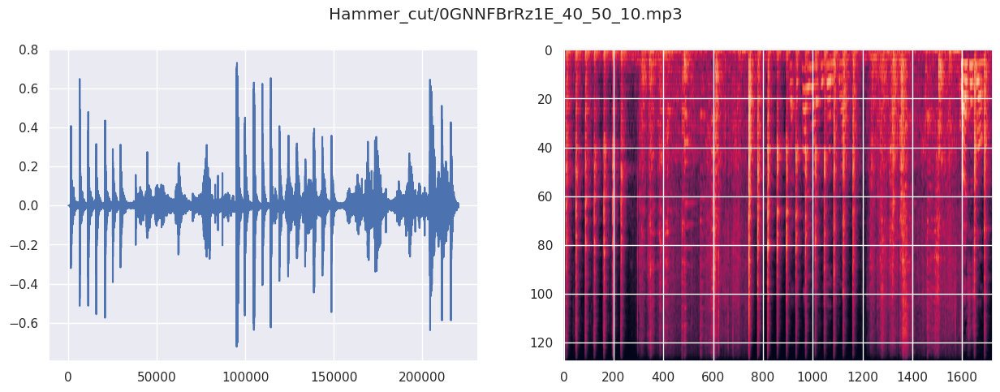

In [71]:
def plot_audio(mp3_path: str) -> None:
    """ 
    En utilisant matplotlib et create_mel_spectrogram() écrivez une fonction qui prend un mp3_path et trace
    à la fois la forme d'onde (graphique linéaire des amplitudes) et le spectrogramme mel côte à côte en tant que subplots.

    Utilisez le mp3_path comme titre principal unique pour tout le graphique

    Indice: Pour le graphique linéaire des amplitudes, essayez de juste de .plot les données retournées par librosa
    """
    sns.set()
    fig, axs = plt.subplots(1, 2, figsize=(15, 5))
    fig.suptitle(mp3_path)
    data, sr = librosa.load(mp3_path)
    axs[0].plot(data)
    axs[1].imshow(create_mel_spectrogram(mp3_path), aspect='auto')
    plt.show()

plot_audio("Hammer_cut/0GNNFBrRz1E_40_50_10.mp3")